# Clustering

In this notebook we do the three types of clustering discussed 

In [13]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from libraries.clustering import apply_pca, plot_results, apply_tsne, apply_umap
from libraries import clustering
from sklearn.cluster import KMeans, OPTICS, DBSCAN
from scipy.spatial.distance import squareform
from sklearn.cluster import DBSCAN
import numpy as np
from sklearn.cluster import SpectralClustering
from pyclustering.cluster.optics import optics, ordering_analyser
from libraries.clustering import sil_vs_coh
from sklearn.metrics import pairwise_distances

In [14]:
DATASET_DIR = "dataset" + os.sep
RESULTS_DIR = "results" + os.sep

In [15]:
merged_df = pd.read_csv(DATASET_DIR + "merge_clean_v2-AD.csv", parse_dates=["date"])
cyclist_df = pd.read_csv(DATASET_DIR + "cyclist_clean_v3.csv")
stages_df = pd.read_csv(DATASET_DIR + "stages_clean_v3.csv")

In [16]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [17]:
# Drop rows containing missing values (NaN) in the 'cyclist_df' DataFrame.
# This ensures that any incomplete data is removed from the DataFrame before analysis or modeling.
cyclist_df = cyclist_df.dropna()

# Drop rows containing missing values (NaN) in the 'stages_df' DataFrame in the same manner.
# This keeps the dataset clean by removing rows with missing or incomplete data.
stages_df = stages_df.dropna()


In [18]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [19]:
# List of categorical columns for transformation in the 'cyclist_df' DataFrame.
# These columns will not be transformed since we are leaving them as categorical features.
cat_cyclist = []

# List of columns to standardize in the 'cyclist_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_cyclist = ["height", "birth_year", 'avg_pos', 'num_races']

# List of columns to apply MinMax scaling in the 'cyclist_df' DataFrame.
# In this case, there are no columns specified for MinMax scaling.
minmax_cyclist = []

# Apply the transformation to the 'cyclist_df' DataFrame using the 'clustering.transform' method.
# It applies standardization, MinMax scaling, and encoding for categorical columns (if any).
# The result is the transformed data and the preprocessor (which holds information about how the data was transformed).
transformed_cyclists_data, preprocessor_cyclists = clustering.transform(
    cyclist_df,
    categorical_cols=cat_cyclist,
    standardize_cols=stand_cyclist,
    minmax_cols=minmax_cyclist,
)

# List of categorical columns for transformation in the 'stages_df' DataFrame.
# These columns are not specified here, as no categorical columns are being transformed.
cat_stage = []

# List of columns to standardize in the 'stages_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_stage = ["year", "length", "startlist_quality", 'avg_age_by_url', 'avg_delta_by_url', 'min_age_by_url', 'points']

# List of columns to apply MinMax scaling in the 'stages_df' DataFrame.
# Again, no columns are specified for MinMax scaling.
minmax_stage = []

# Apply the transformation to the 'stages_df' DataFrame using the 'clustering.transform' method.
# This applies standardization, MinMax scaling, and encoding for categorical columns (if any).
transformed_stages_data, preprocessor_stages = clustering.transform(
    stages_df,
    categorical_cols=cat_stage,
    minmax_cols=minmax_stage,
    standardize_cols=stand_stage
)

# Convert the transformed data for cyclists into a DataFrame.
# The transformed data now contains the processed values based on the specified transformations.
transformed_cyclists_df = pd.DataFrame(transformed_cyclists_data)

# Convert the transformed data for stages into a DataFrame.
# Similarly, the transformed stage data is now structured into a DataFrame.
transformed_stages_df = pd.DataFrame(transformed_stages_data)

# Add back the one-hot encoded columns' names to the transformed DataFrame for cyclists.
# This ensures that the transformed DataFrame has appropriate column names reflecting the transformations applied.
transformed_cyclists_df.columns = preprocessor_cyclists.get_feature_names_out(
    cyclist_df.columns
)

# Add back the one-hot encoded columns' names to the transformed DataFrame for stages.
# This ensures that the transformed DataFrame for stages has appropriate column names.
transformed_stages_df.columns = preprocessor_stages.get_feature_names_out(
    stages_df.columns
)

# Reset the index of the transformed cyclists DataFrame to ensure that indices are continuous after transformation.
transformed_cyclists_df.reset_index(drop=True, inplace=True)

# Reset the index of the transformed stages DataFrame in the same way to ensure continuous indices.
transformed_stages_df.reset_index(drop=True, inplace=True)

# Add the '_url' column back to the transformed cyclists DataFrame.
# The '_url' column is kept from the original 'cyclist_df' DataFrame for reference.
transformed_cyclists_df["_url"] = cyclist_df["_url"]

# Add the '_url' column back to the transformed stages DataFrame for reference.
transformed_stages_df["_url"] = stages_df["_url"]

# Drop the '_url' column from the transformed cyclists DataFrame as it's no longer needed after adding it back.
transformed_cyclists_df.drop(columns=["_url"], inplace=True)

# Drop the '_url' column from the transformed stages DataFrame similarly.
transformed_stages_df.drop(columns=["_url"], inplace=True)


In [20]:
transformed_cyclists_df.info()
transformed_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

Create a version of the dataframes without categorical columns

In [21]:
def filter_one_hot_columns(df):
    return df.loc[:, ~df.columns.str.startswith("cat__")]


real_cyclists_df = filter_one_hot_columns(transformed_cyclists_df)
real_stages_df = filter_one_hot_columns(transformed_stages_df)

real_cyclists_df.info()
real_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

In [22]:
cyclists = clustering.inverse_transform(transformed_cyclists_data, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
stages = clustering.inverse_transform(transformed_stages_data, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

## K-means

### K-Means cyclists

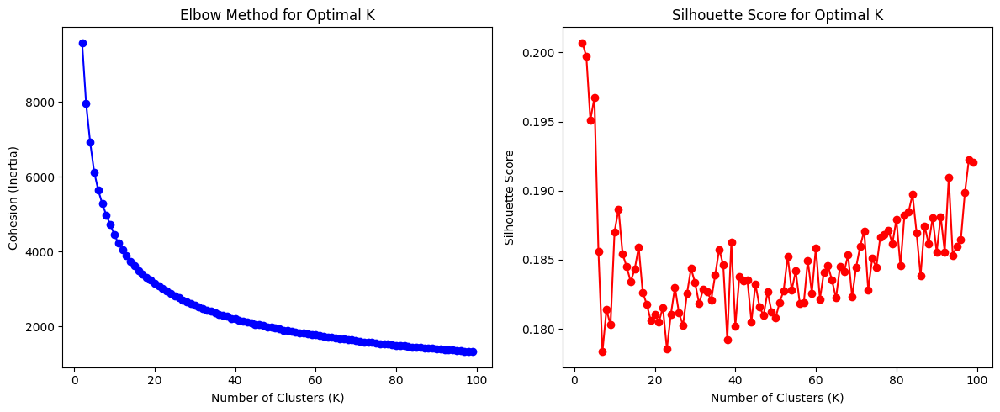

In [23]:
kmeans_list = clustering.plot_scores(real_cyclists_df)

In [24]:
kmeans = kmeans_list[7]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
#clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)

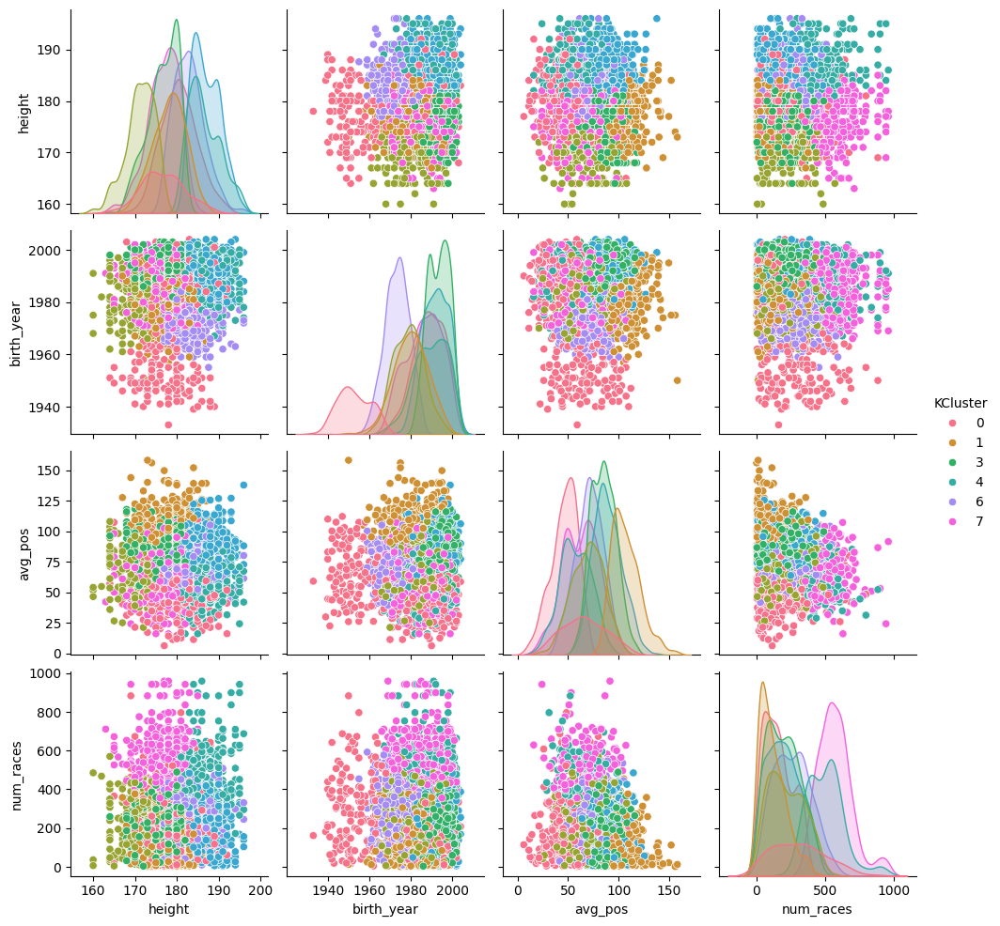

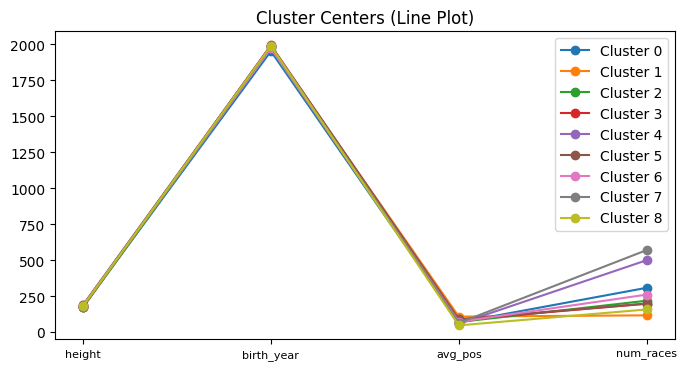

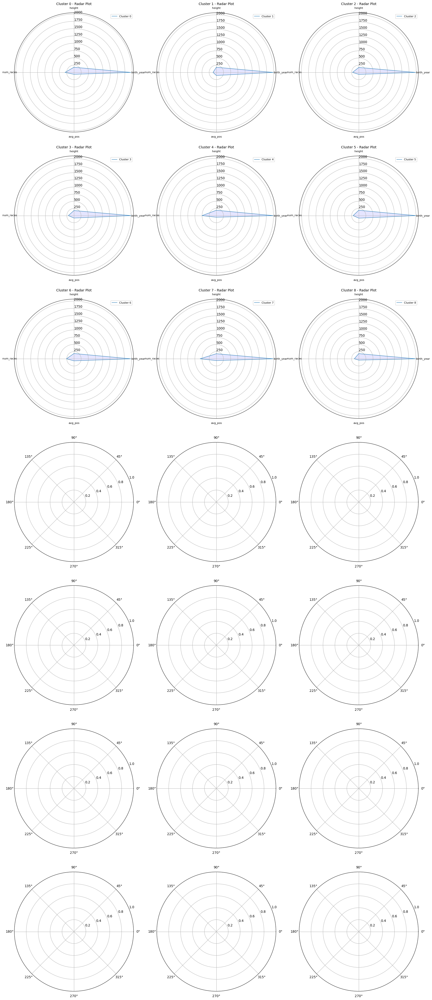

       height   birth_year     avg_pos   num_races
0  176.678322  1952.671329   65.832422  307.342657
1  178.176129  1979.958065  107.142088  115.877419
2  171.186047  1978.940199   69.347511  217.465116
3  176.604819  1993.236145   84.800146  196.568675
4  186.582237  1989.453947   57.280157  499.292763
5  186.998437  1991.718750   88.836787  197.893229
6  182.815504  1973.211886   70.831761  259.974160
7  176.706796  1986.213592   62.778056  569.526699
8  180.558242  1988.980769   46.102443  156.703297
height          5.165331
birth_year     12.709413
avg_pos        18.365744
num_races     155.247726
dtype: float64


In [25]:
clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)
clustering.plot_centers(cyclists, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

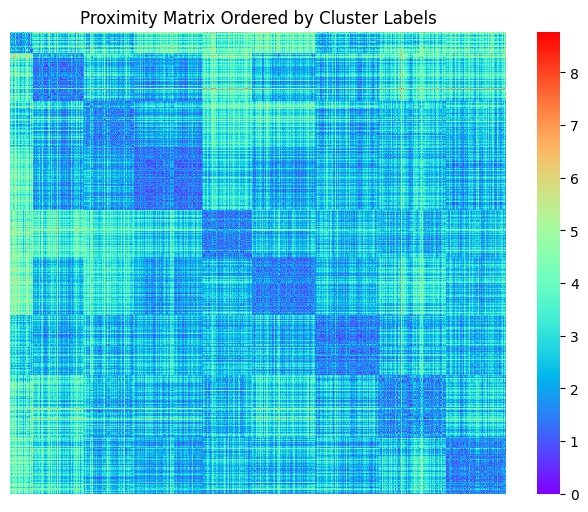

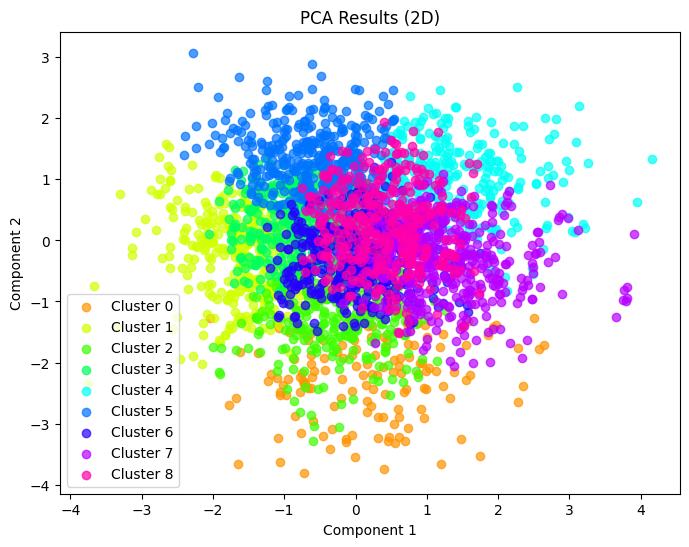

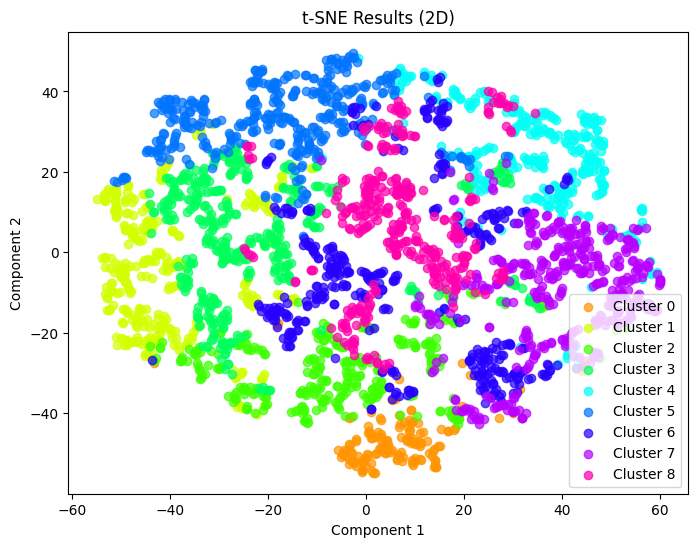

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


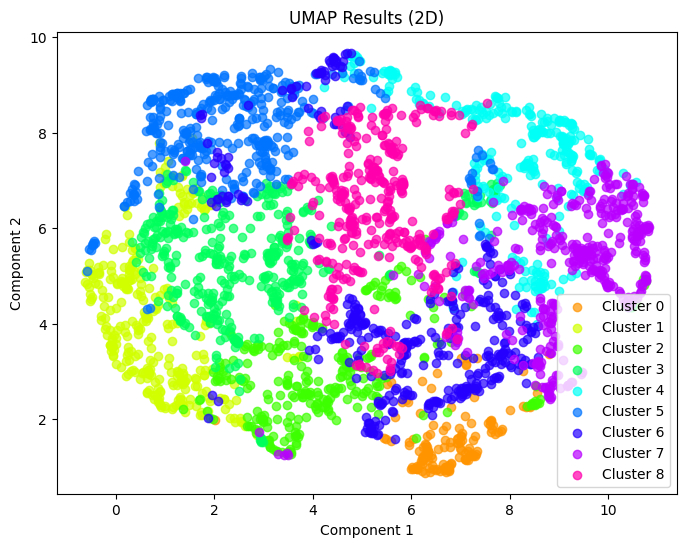

In [26]:
data_scaled = real_cyclists_df
labels = kmeans.labels_

clustering.similarity_matrix(real_cyclists_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### K-Means stages

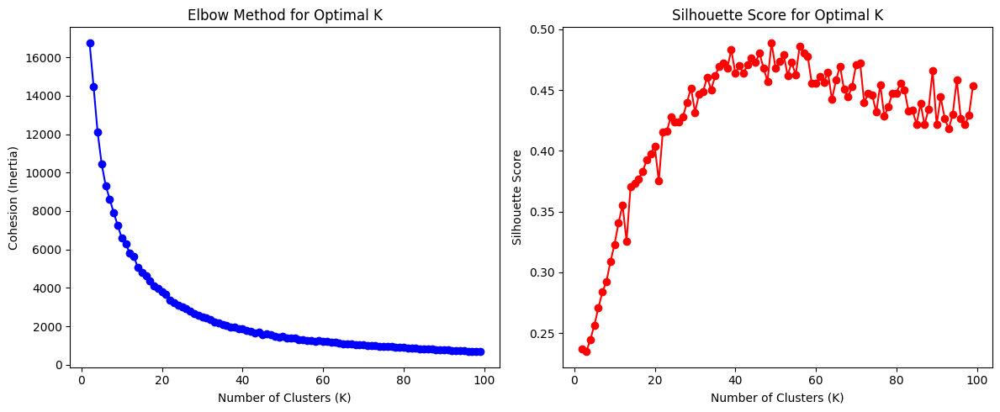

In [27]:
kmeans_list = clustering.plot_scores(real_stages_df)

Plots for optimal K

In [28]:
kmeans = kmeans_list[10]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

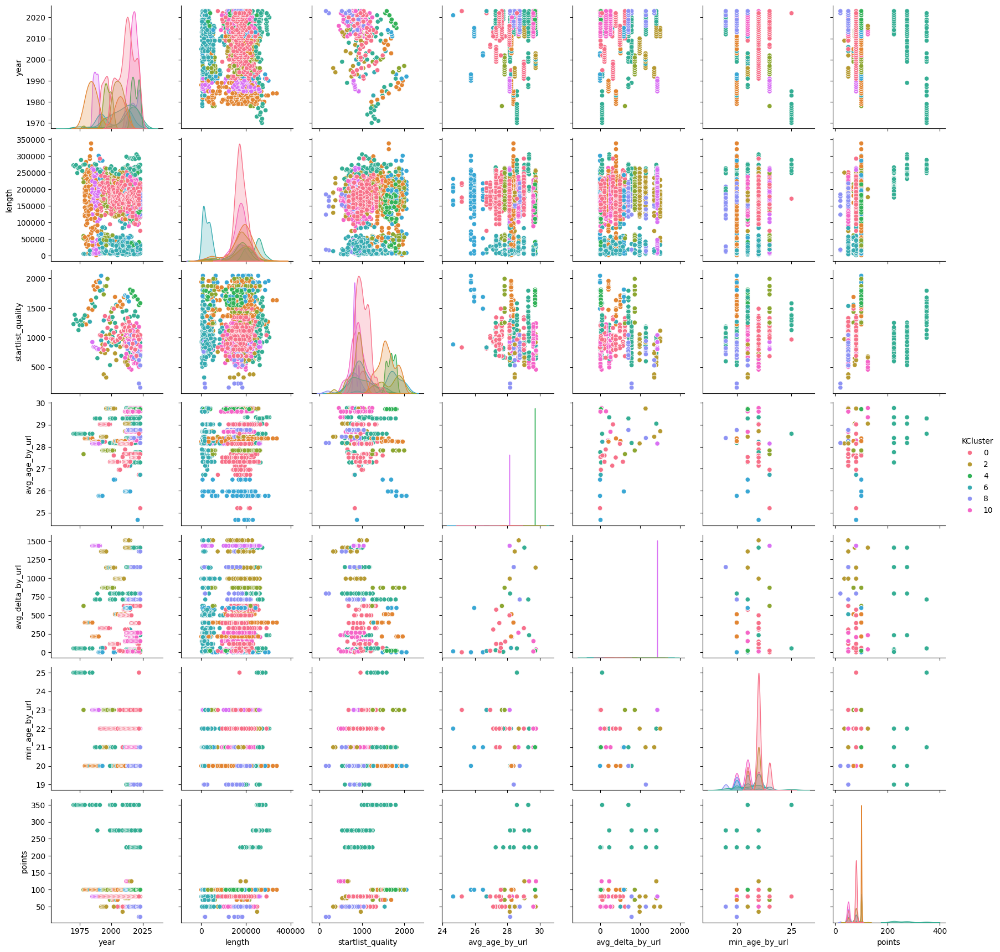

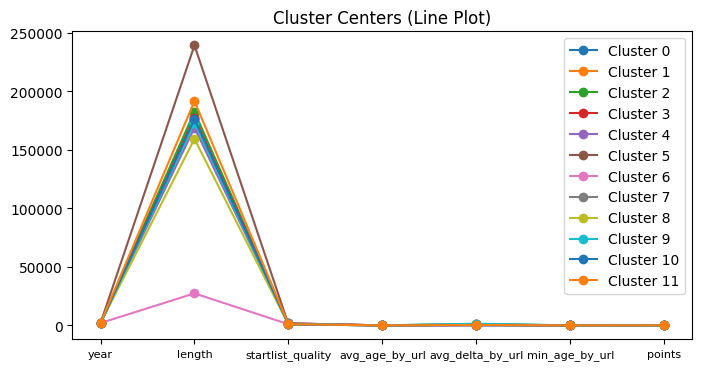

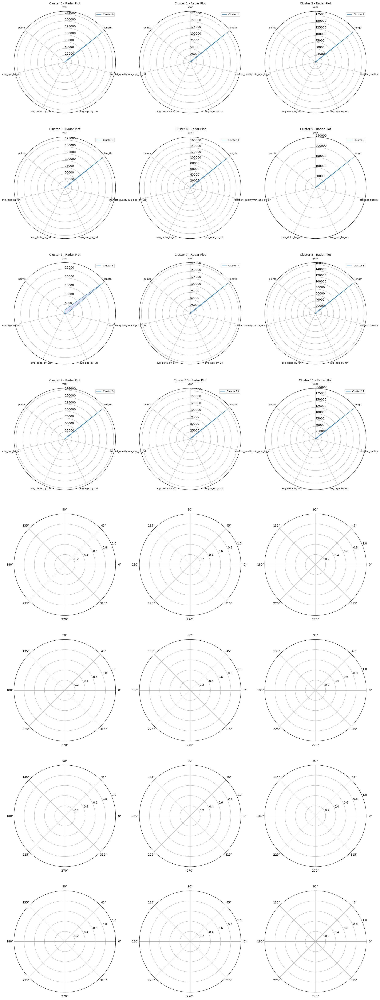

           year         length  startlist_quality  avg_age_by_url  \
0   2012.144776  176896.567164        1009.313433       27.562124   
1   1992.728997  179696.205962        1589.945799       28.295095   
2   2005.044000  182461.200000         870.408000       28.614322   
3   1996.694444  177395.833333        1665.798611       27.825445   
4   2019.078947  168831.578947        1684.986842       29.708571   
5   2012.111111  239203.986928         985.745098       28.731207   
6   2008.880342   27358.974359        1007.320513       28.346246   
7   2004.578231  173573.469388        1729.455782       25.851648   
8   2019.050420  159314.873950         764.689076       28.593397   
9   1987.614173  173268.503937         844.173228       28.140940   
10  2017.632812  176218.229167         890.406250       29.062938   
11  1994.760274  191600.684932        1014.732877       29.012231   

    avg_delta_by_url  min_age_by_url      points  
0         373.319585       22.031343   75.388060  


In [29]:
clustering.optimal_pair_plot(stages, 'KCluster', kmeans.labels_)
clustering.plot_centers(stages, centers, 8, 3)
print(centers)
print(centers.std().sort_values())

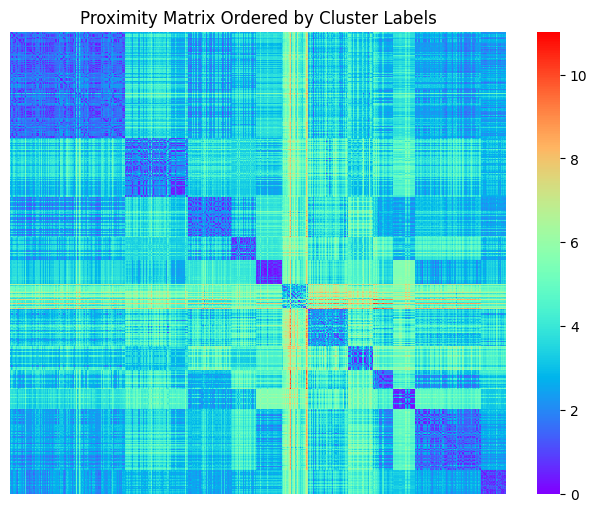

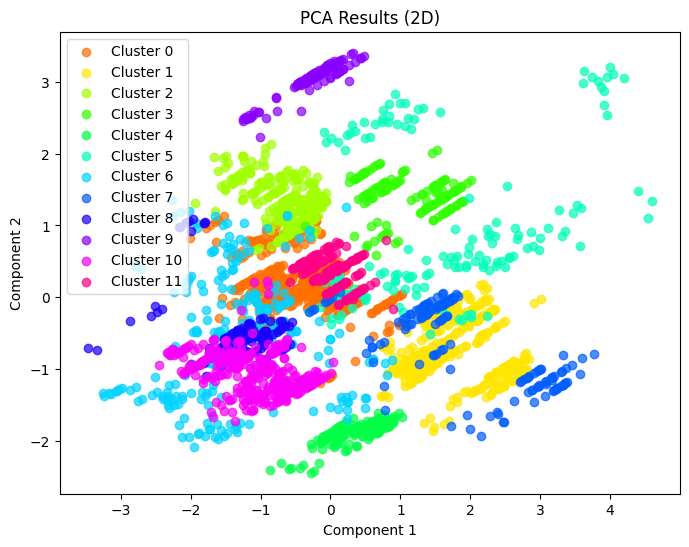

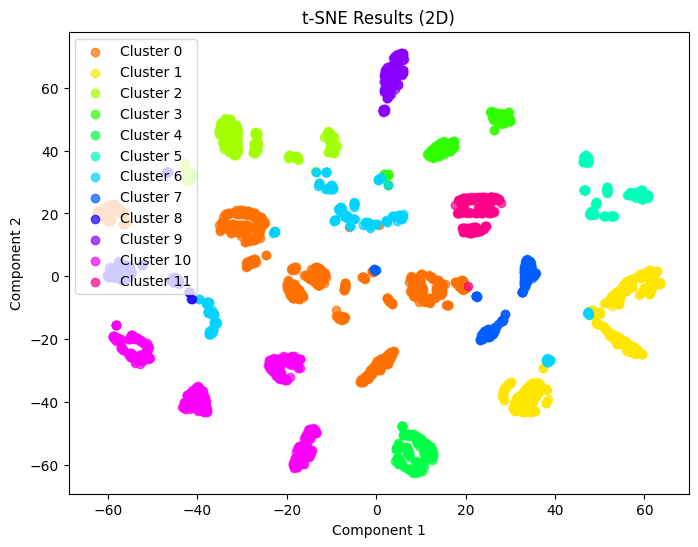

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


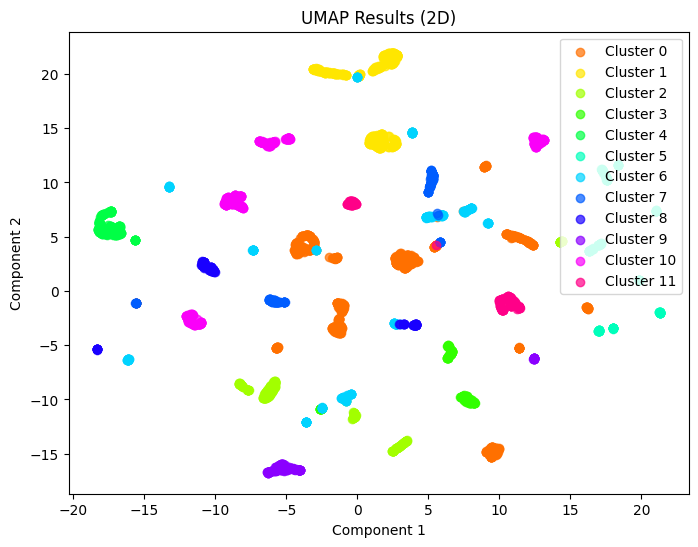

In [30]:
data_scaled = real_stages_df
labels = kmeans.labels_

clustering.similarity_matrix(real_stages_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### X-means cyclists

In [31]:
from sklearn.metrics import silhouette_score

labels, centroid = clustering.x_means(real_cyclists_df)

print(f"Silouette: {silhouette_score(real_cyclists_df, labels)}")

Done
Silouette: 0.19723360601600054


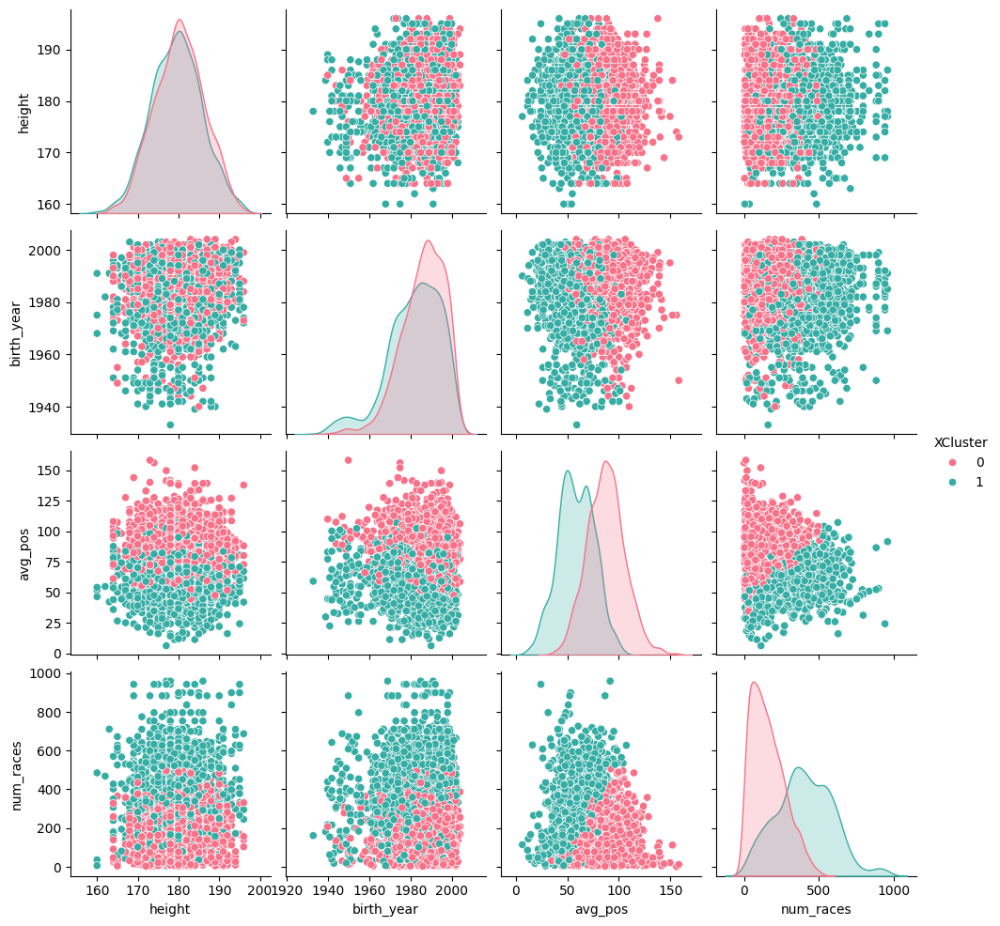

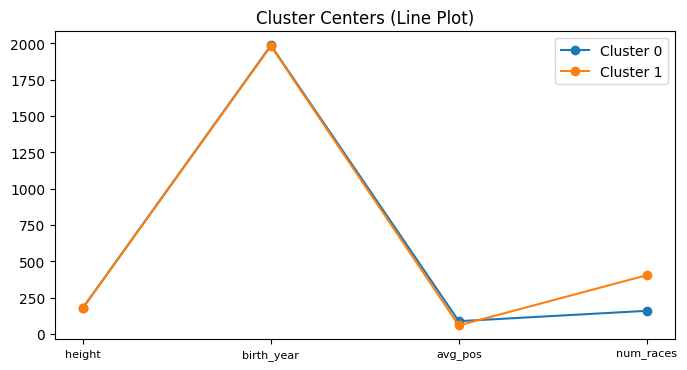

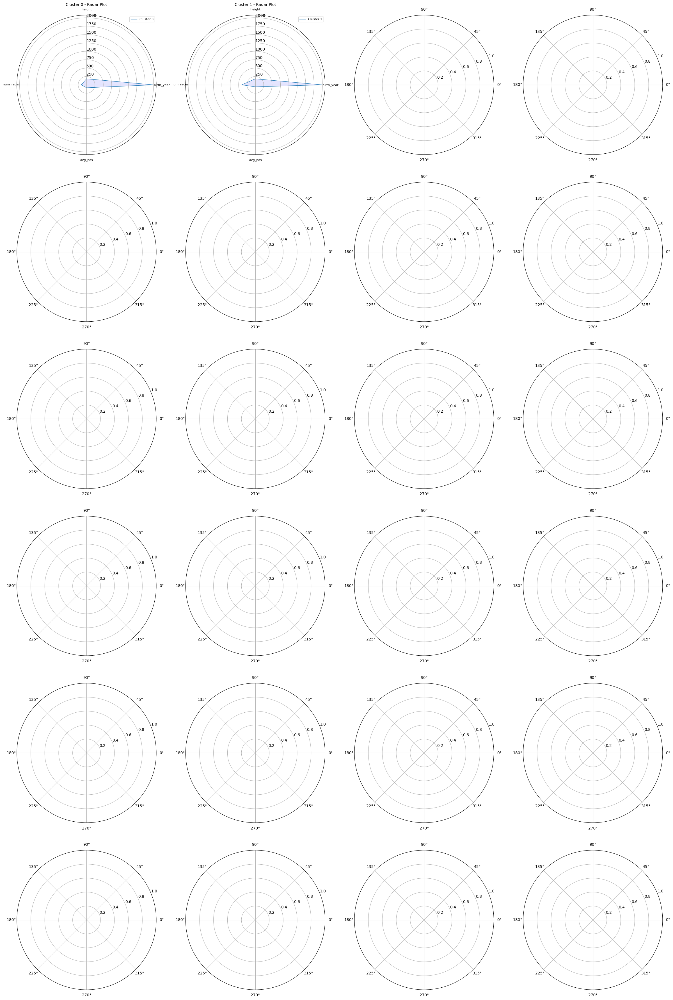

      height   birth_year    avg_pos   num_races
0  180.19697  1985.980237  87.262025  158.640316
1  179.48269  1981.831558  58.464864  403.568575
height          0.505072
birth_year      2.933559
avg_pos        20.362668
num_races     173.190433
dtype: float64


In [32]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.optimal_pair_plot(cyclists, 'XCluster', labels)
clustering.plot_centers(cyclists, centers, 6, 4)
print(centers)
print(centers.std().sort_values())

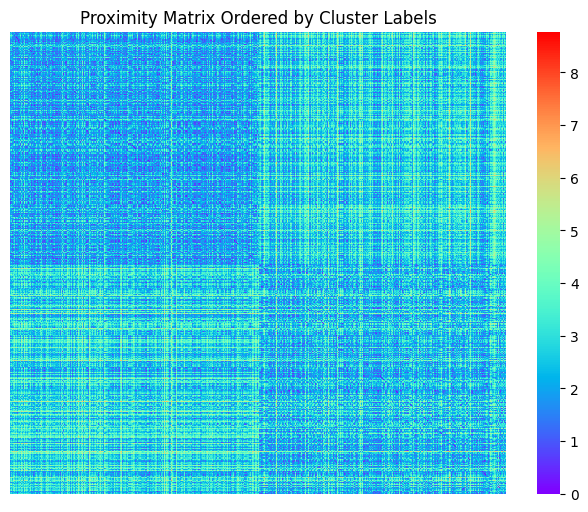

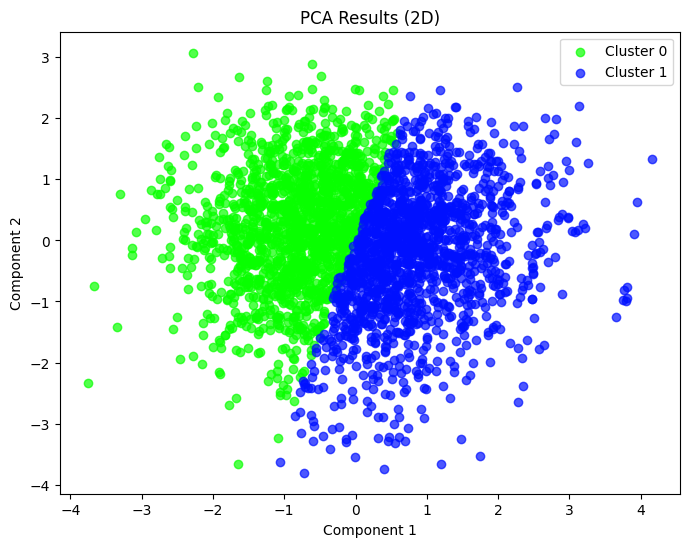

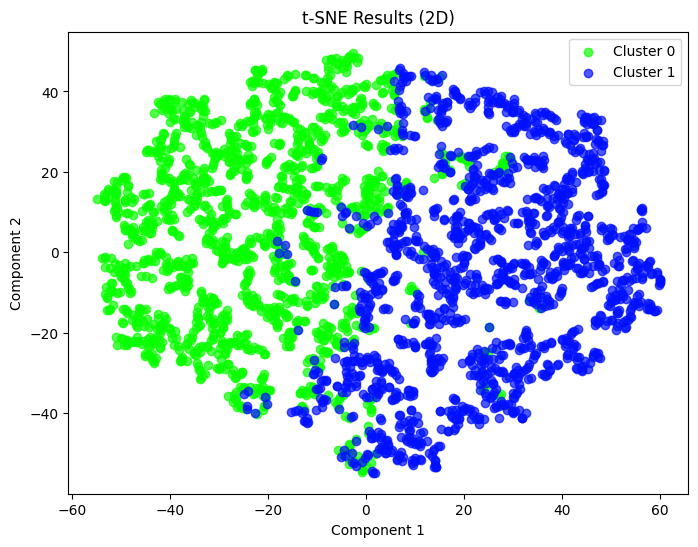

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


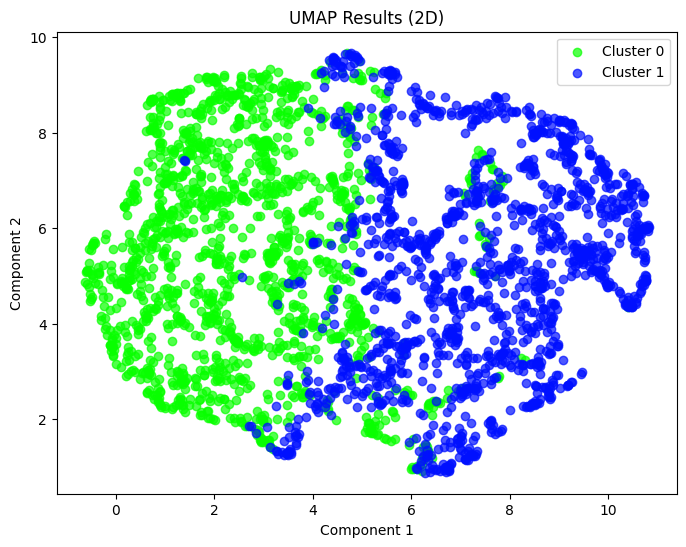

In [33]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### X-means stages

In [34]:
labels, centroid = clustering.x_means(real_stages_df)

print(f"Silouette: {silhouette_score(real_stages_df, labels)}")

Done
Silouette: 0.3821568795180556


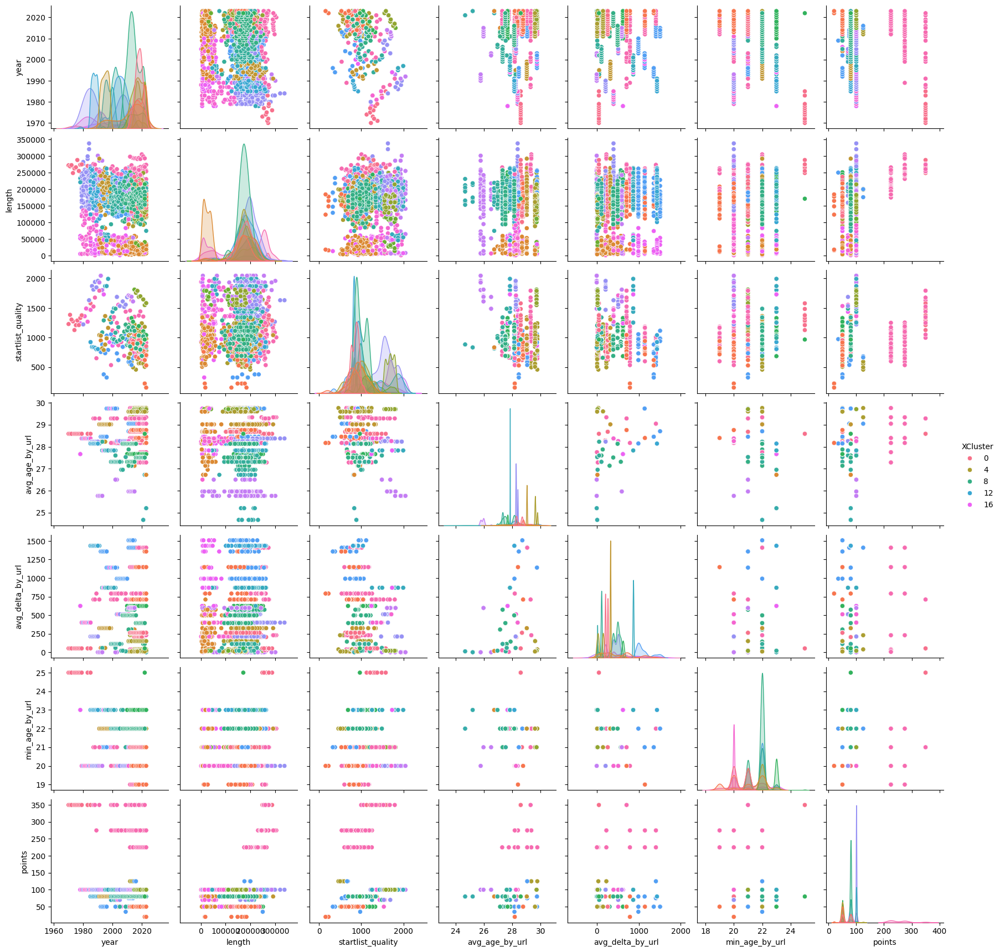

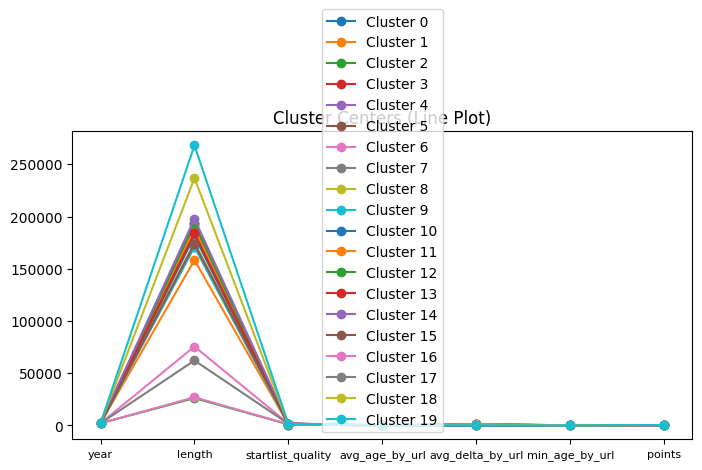

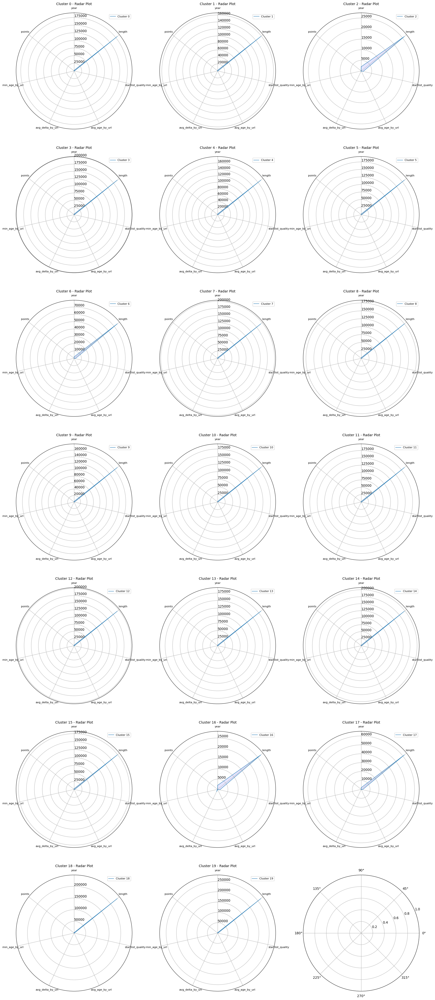

           year         length  startlist_quality  avg_age_by_url  \
0   2017.785340  181252.356021         850.968586       28.474321   
1   2019.083333  158278.916667         765.275000       28.589872   
2   2011.227545   26137.724551         952.485030       28.338672   
3   1994.760274  191600.684932        1014.732877       29.012231   
4   2017.481865  171236.269430         929.435233       29.645456   
5   2019.137405  183791.603053        1683.015267       29.708571   
6   2018.714286   75509.523810        1697.285714       29.708571   
7   2016.567568  194187.837838        1097.689189       27.676210   
8   2014.461905  175041.904762         971.911905       27.703616   
9   2002.736196  171017.177914        1088.822086       27.304034   
10  2022.153846  182830.769231         846.230769       25.795897   
11  1996.977612  188097.014925        1667.082090       27.827583   
12  1987.607143  193416.964286         842.937500       28.140940   
13  2005.044534  183989.068826    

In [35]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.optimal_pair_plot(stages, 'XCluster', labels)
clustering.plot_centers(stages, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

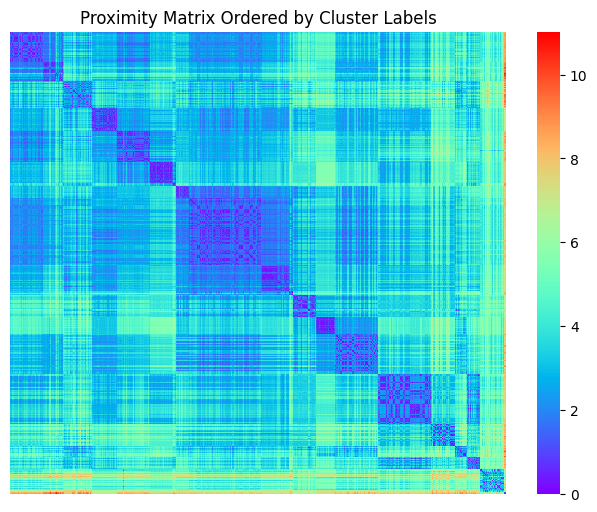

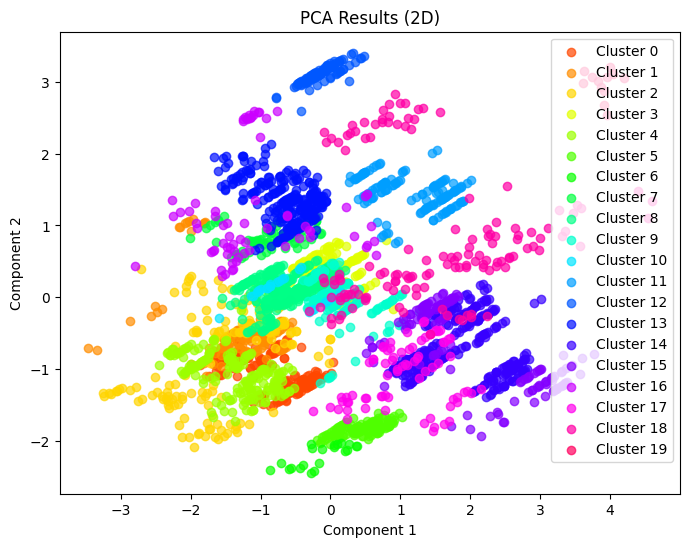

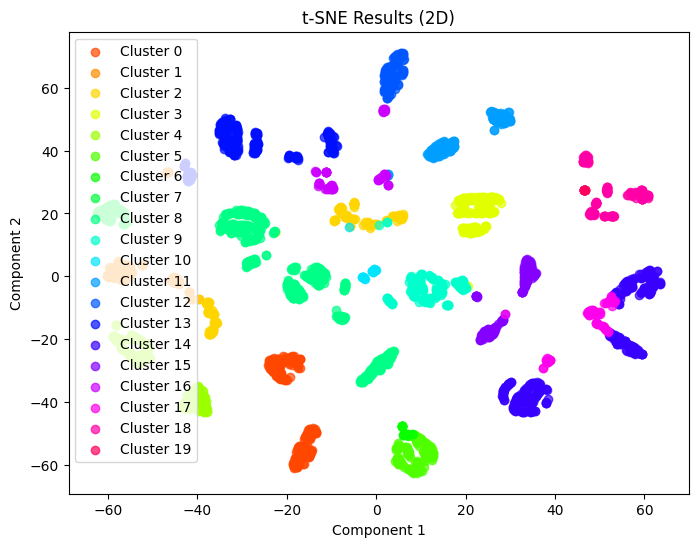

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


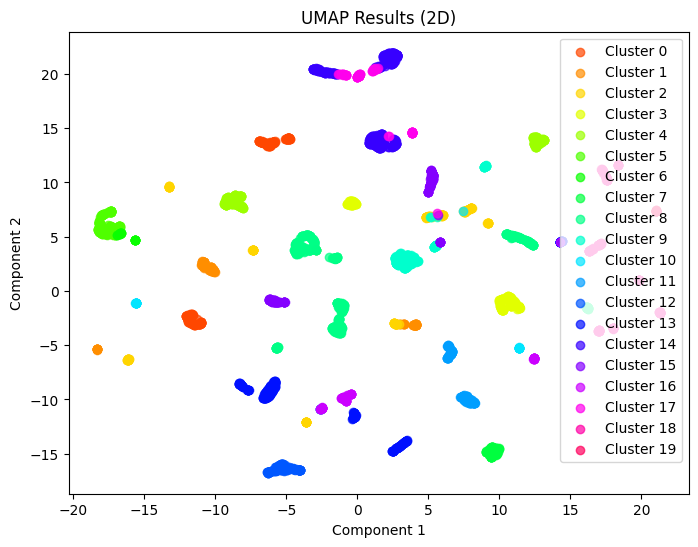

In [36]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

## Hierarchical 

Define linkage methods to try

In [37]:
# Let's use methods less susceptible to outliers and noise
# linkage_methods = ["single", "complete", "average", "ward", "centroid", "median"]
linkage_methods = ["average", "ward", "centroid"]

### Cyclists link

Compute distance matrices for cyclists

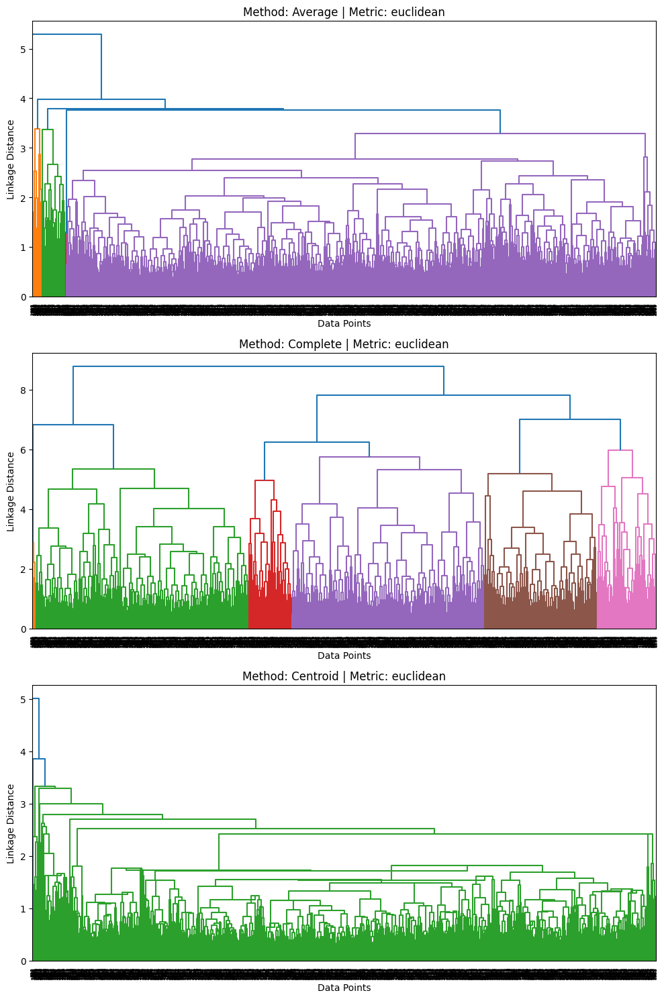

In [38]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_cyclists, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

Here the number of clusters is not perfectly clear, but the maximum distance is enough clear and we can see that the number of clusters is between 2 3 or 4

### Stages links

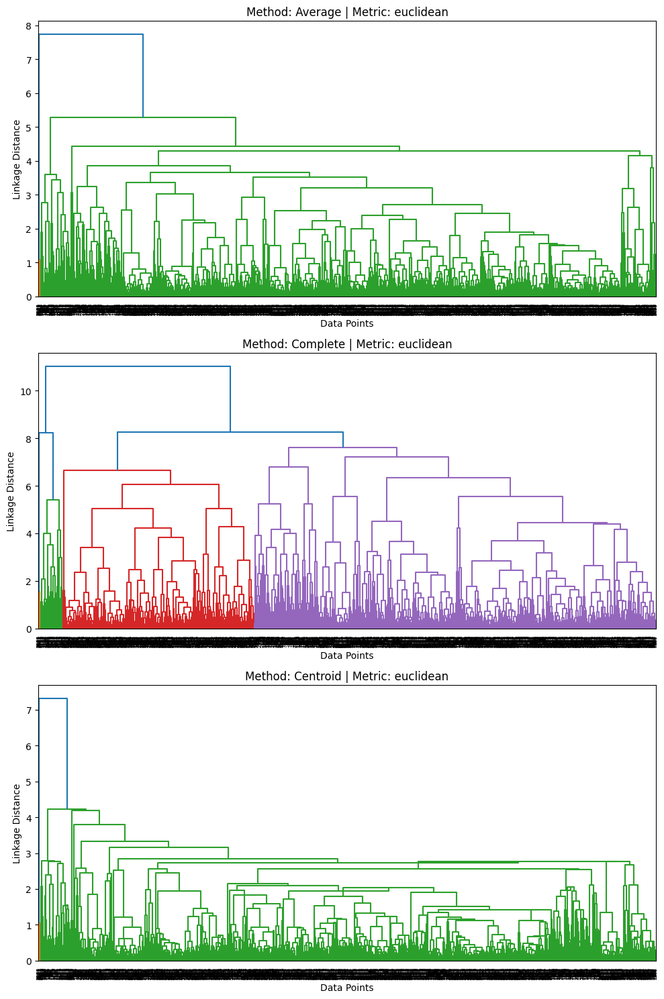

In [39]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_stages, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

2 is where there is the maximum distance. so clusters are 2

### Spectral method

According to spectral method. No clusters are found

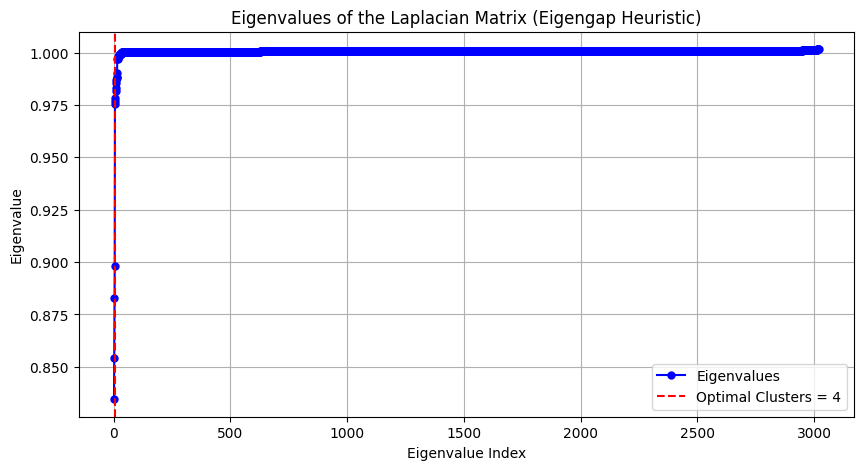

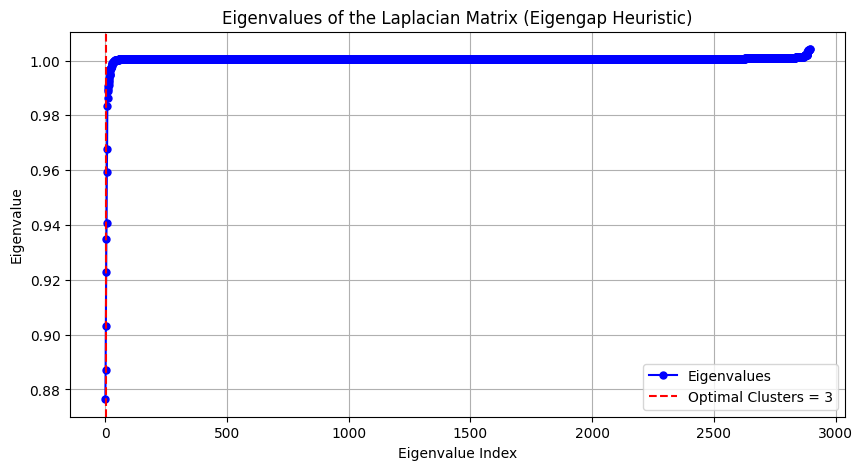

In [40]:
import libraries.clustering as clustering
clustering.spectral_eigen_gap(real_cyclists_df.values)
clustering.spectral_eigen_gap(real_stages_df.values)

### Cyclists agglomerative

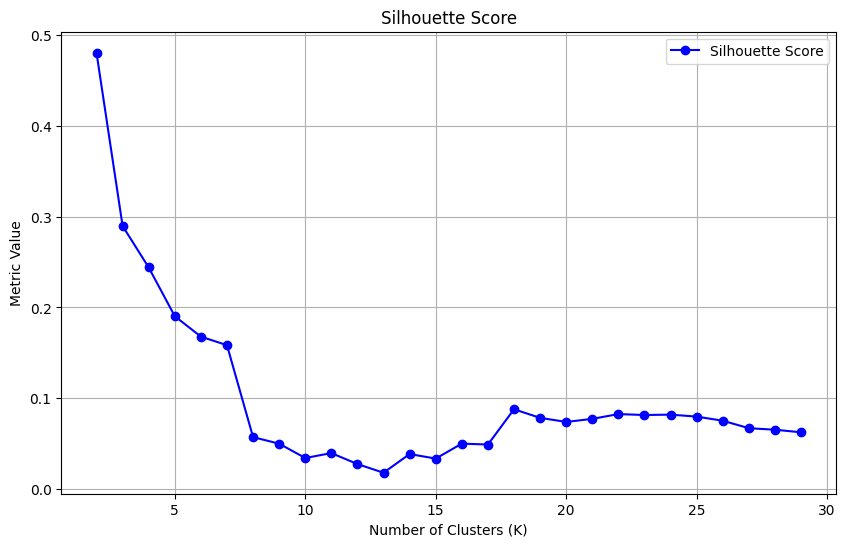

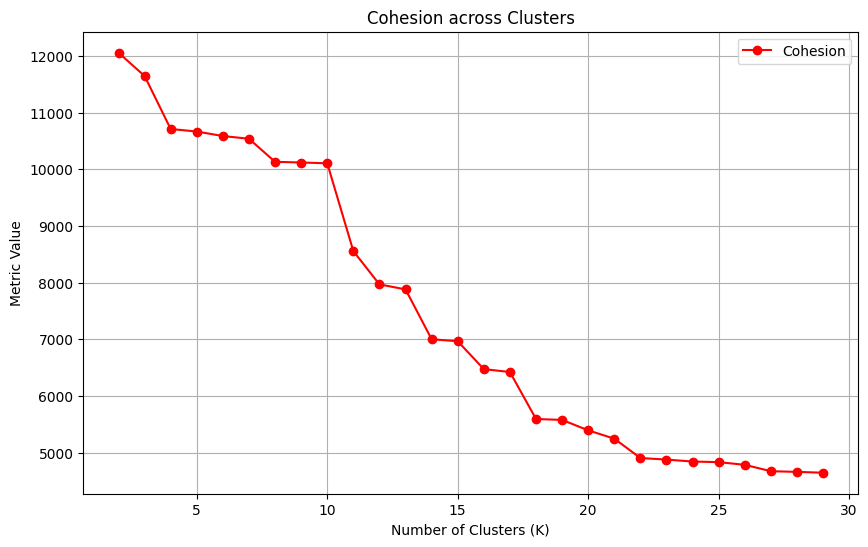

In [41]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_cyclists = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_cyclists.append(agg_clustering.fit_predict(real_cyclists_df))

sil1,coh1 = sil_vs_coh(real_cyclists_df, agglr_labels_cyclists, list(range(2,30)))

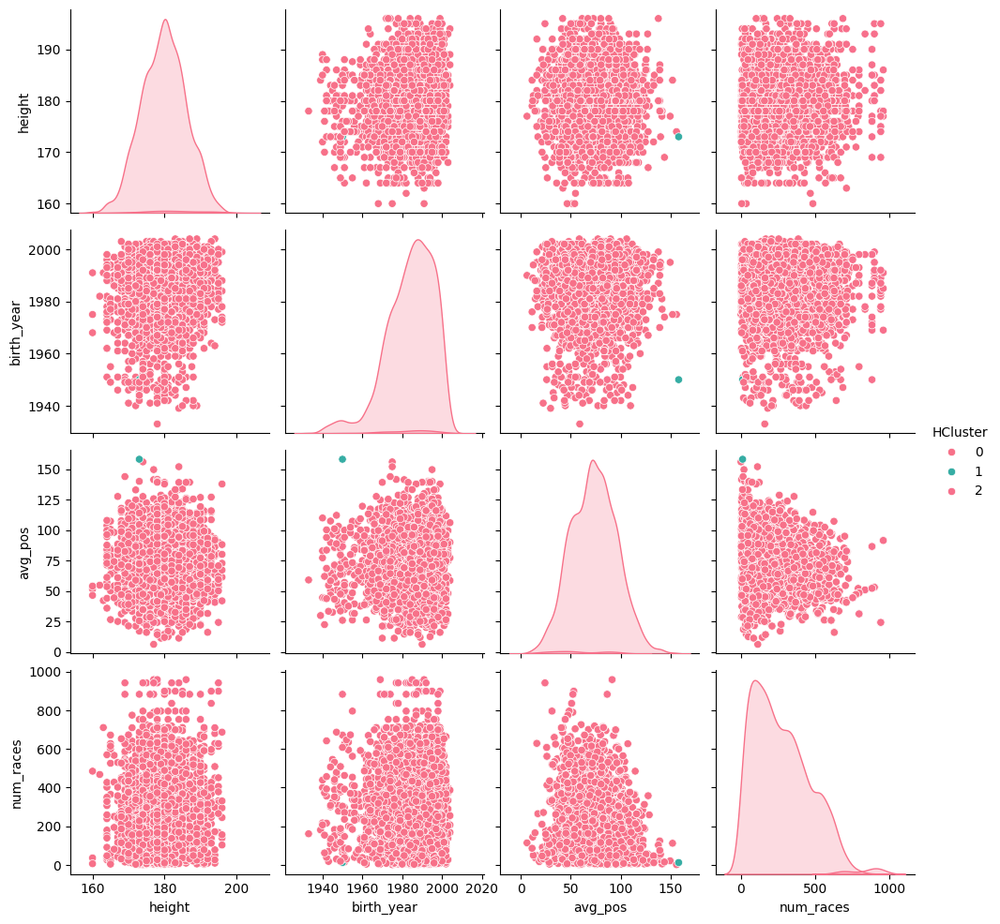

In [42]:
agg_clustering = AgglomerativeClustering(n_clusters=3, linkage='average')
labels = agg_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'HCluster', labels)

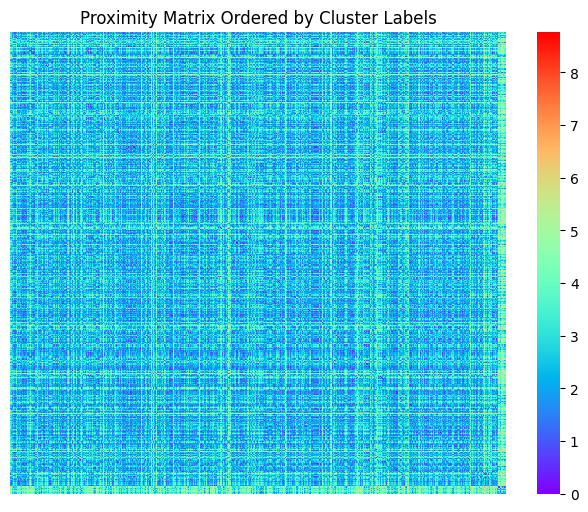

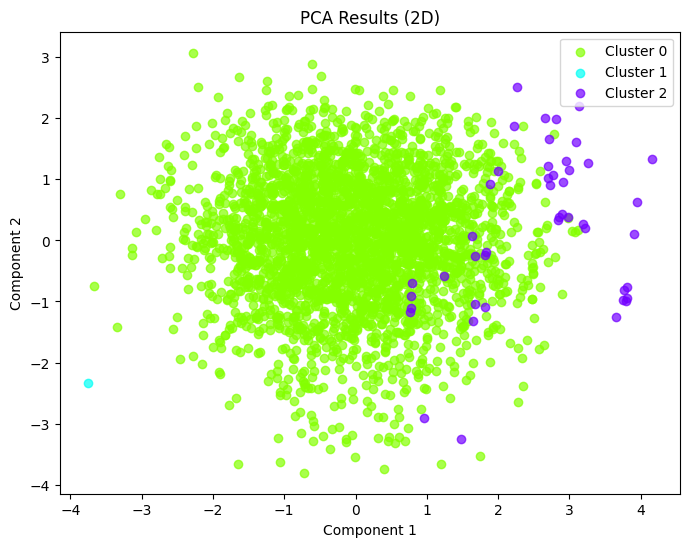

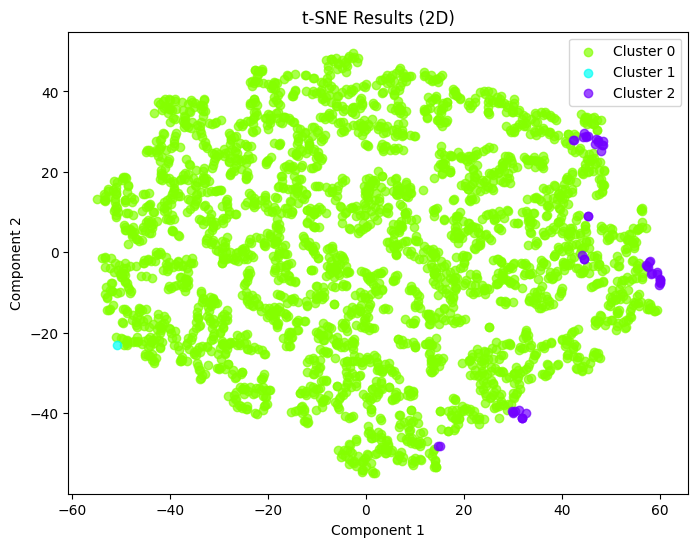

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


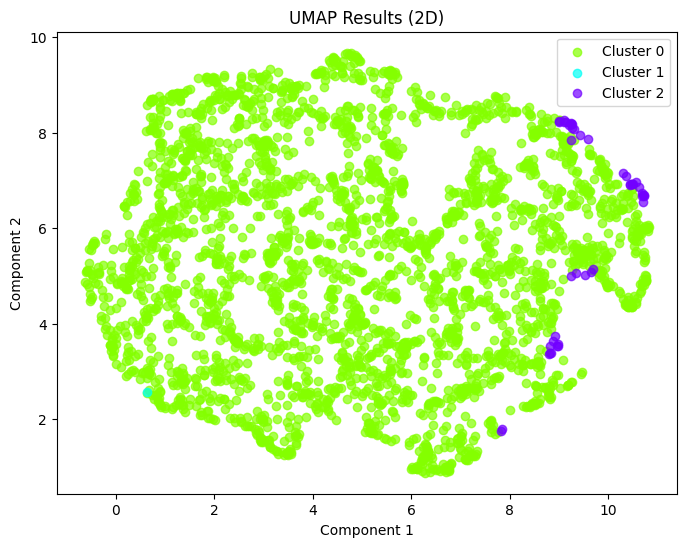

In [43]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Stages agglomerative

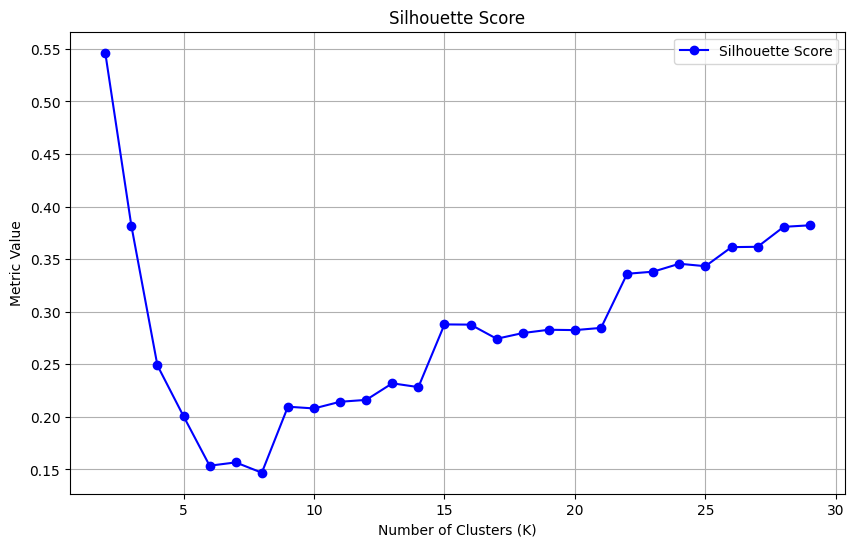

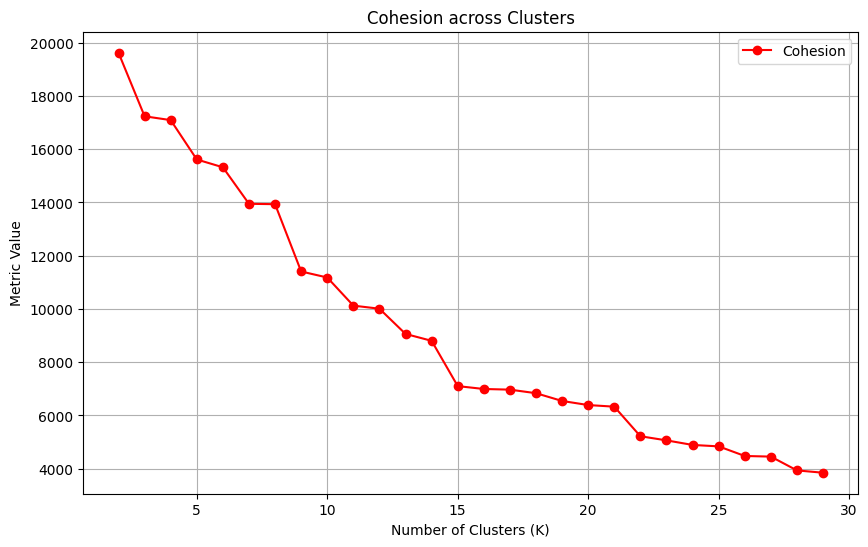

In [44]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_stages = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_stages.append(agg_clustering.fit_predict(real_stages_df))

sil1,coh1 = sil_vs_coh(real_stages_df, agglr_labels_stages, list(range(2,30)))

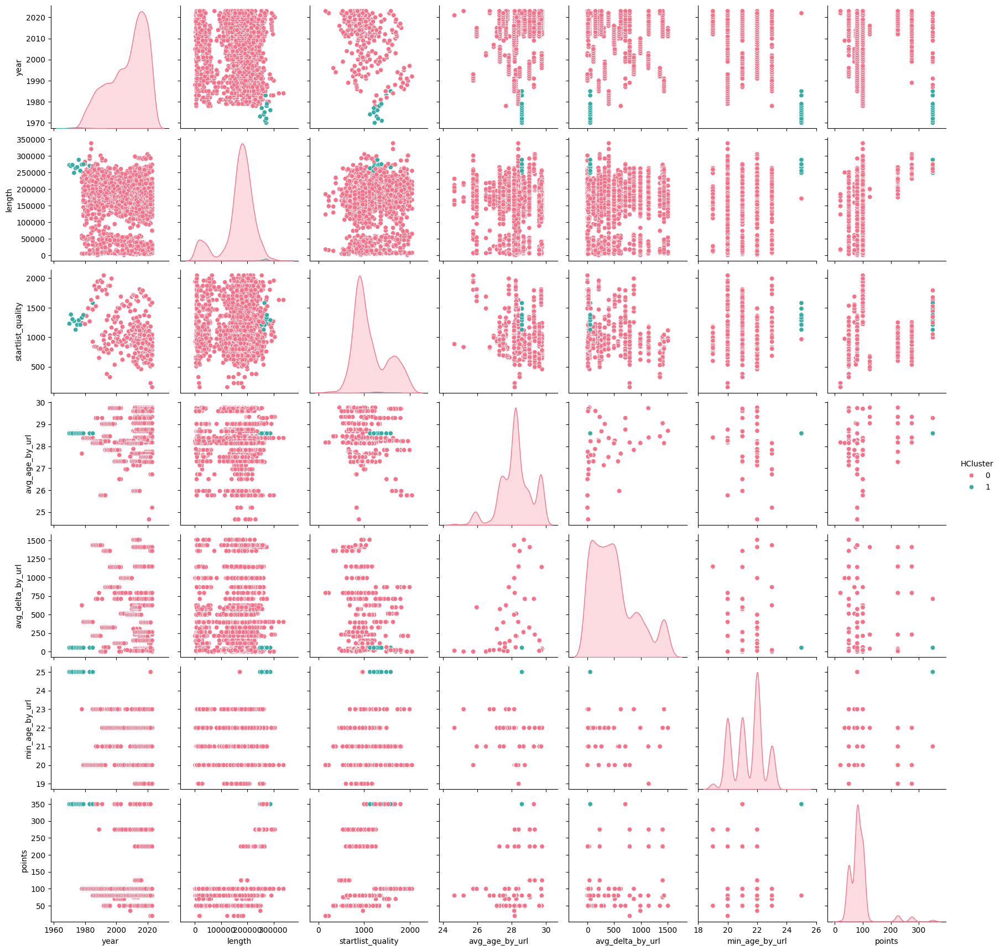

In [45]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='average')
labels = agg_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'HCluster', labels)

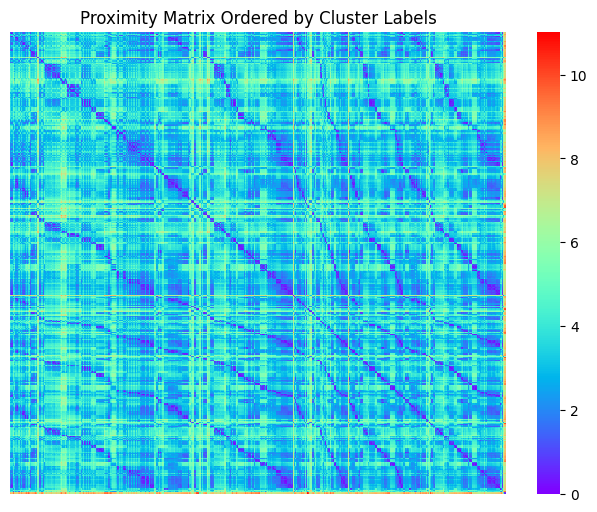

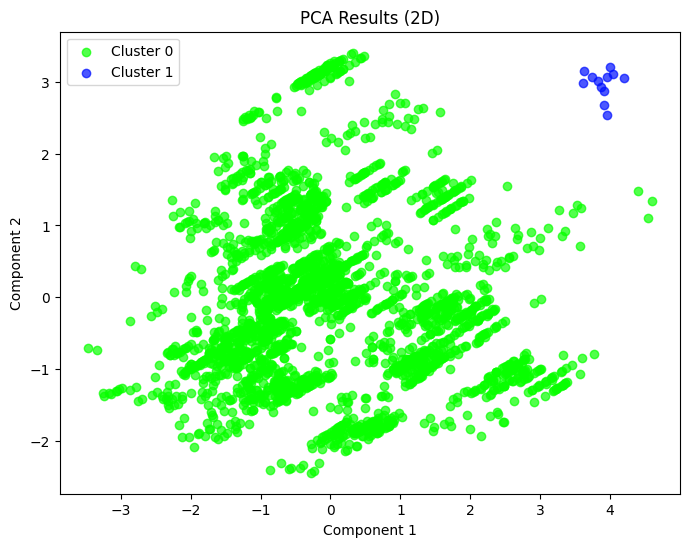

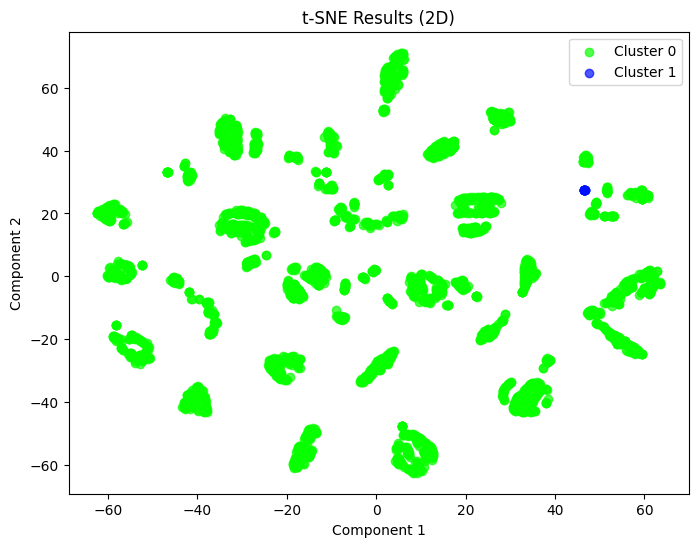

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


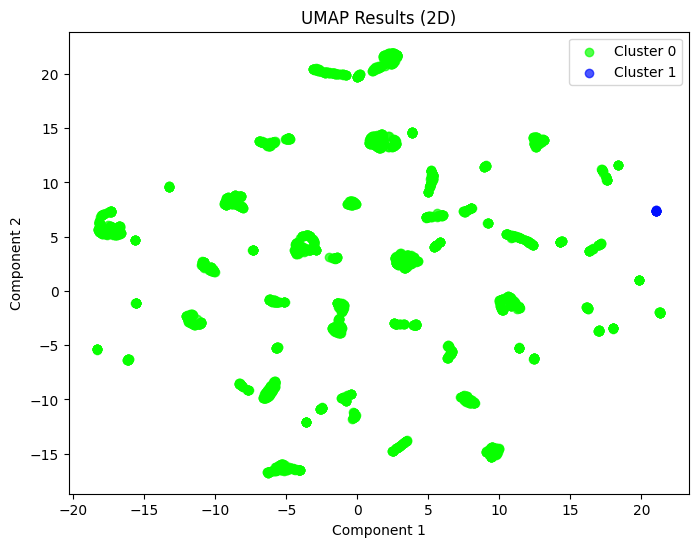

In [46]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Cyclists spectral

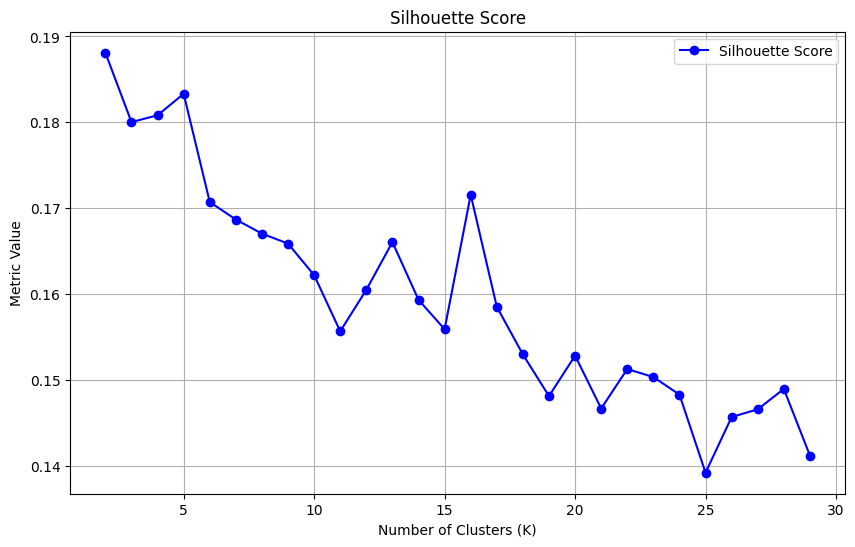

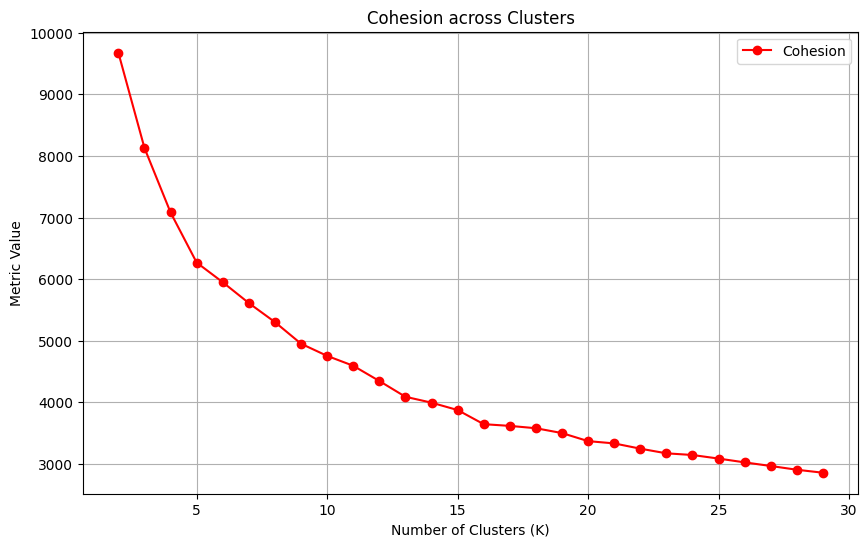

In [47]:
spect_labels_cyclists = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=1804)
    spect_labels_cyclists.append(spectral.fit_predict(real_cyclists_df))

sil3,coh3 = sil_vs_coh(real_cyclists_df, spect_labels_cyclists, list(range(2,30)))

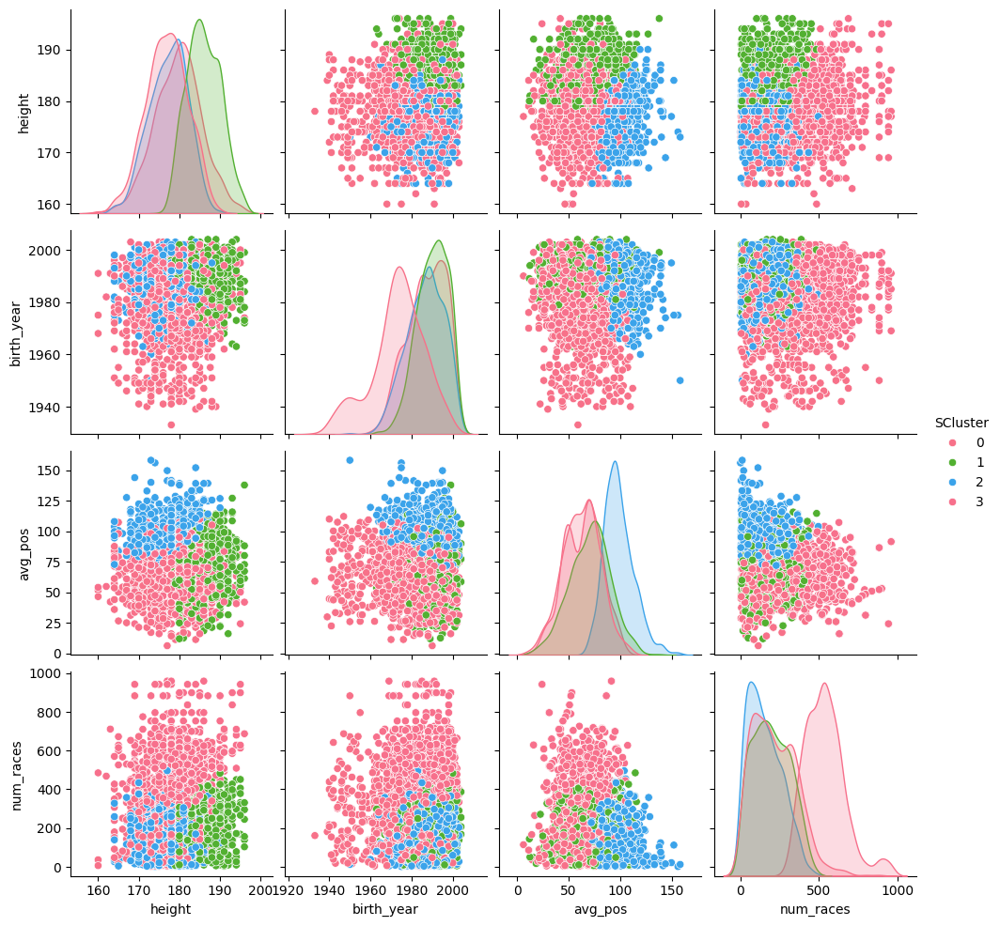

In [48]:
spect_clustering = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=1804)
labels = spect_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'SCluster', labels)

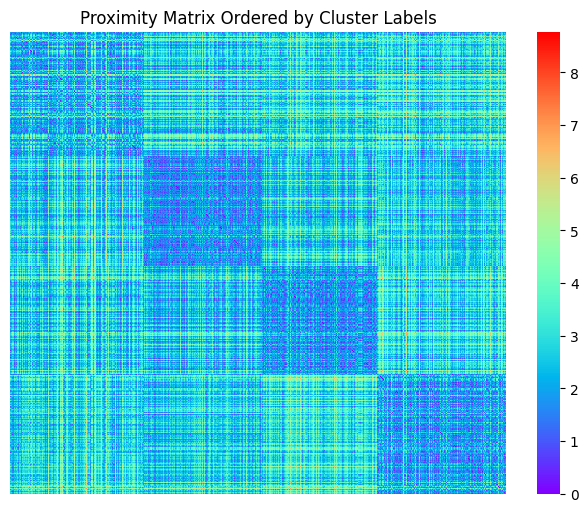

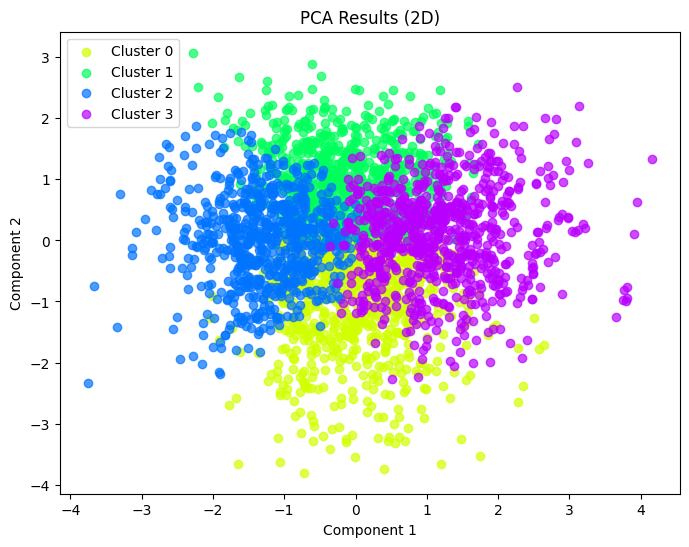

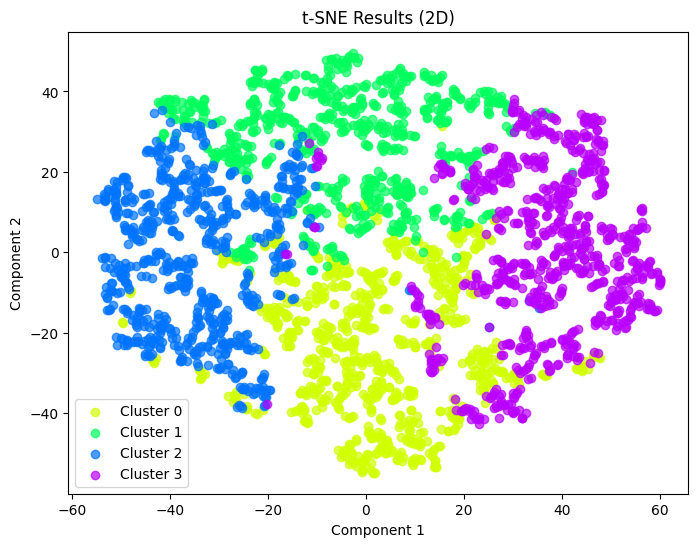

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


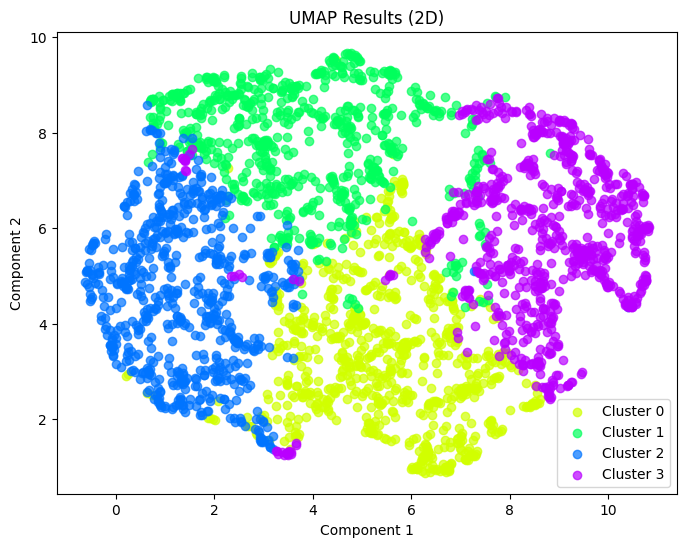

In [49]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Stages spectral

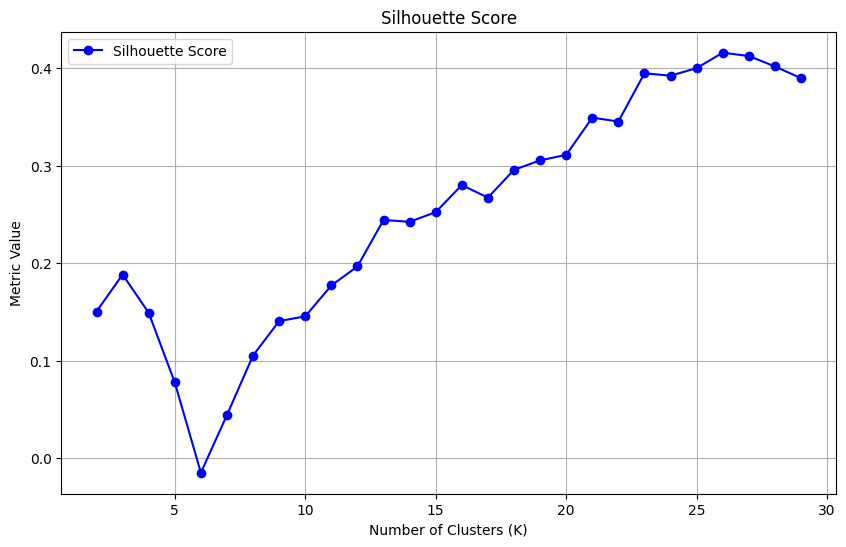

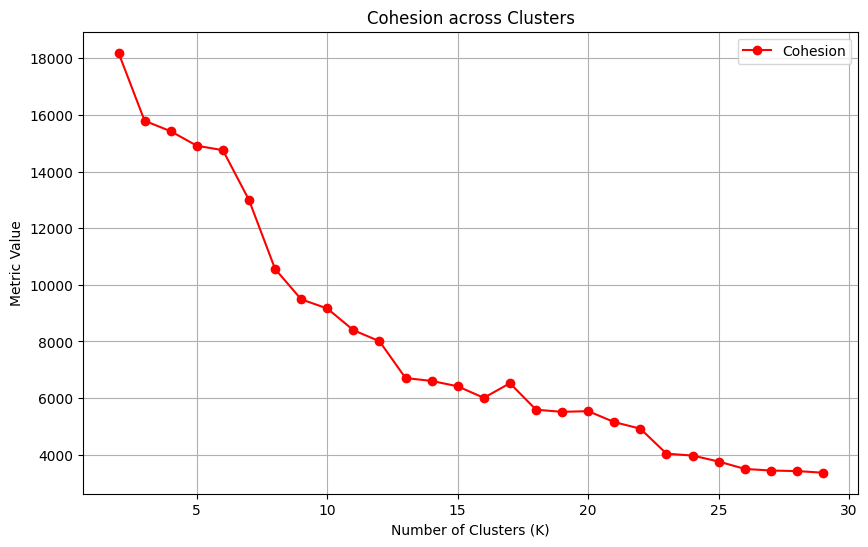

In [50]:
from sklearn.cluster import SpectralClustering

spect_labels_stages = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
    spect_labels_stages.append(spectral.fit_predict(real_stages_df))

sil4,coh4 = sil_vs_coh(real_stages_df, spect_labels_stages, list(range(2,30)))

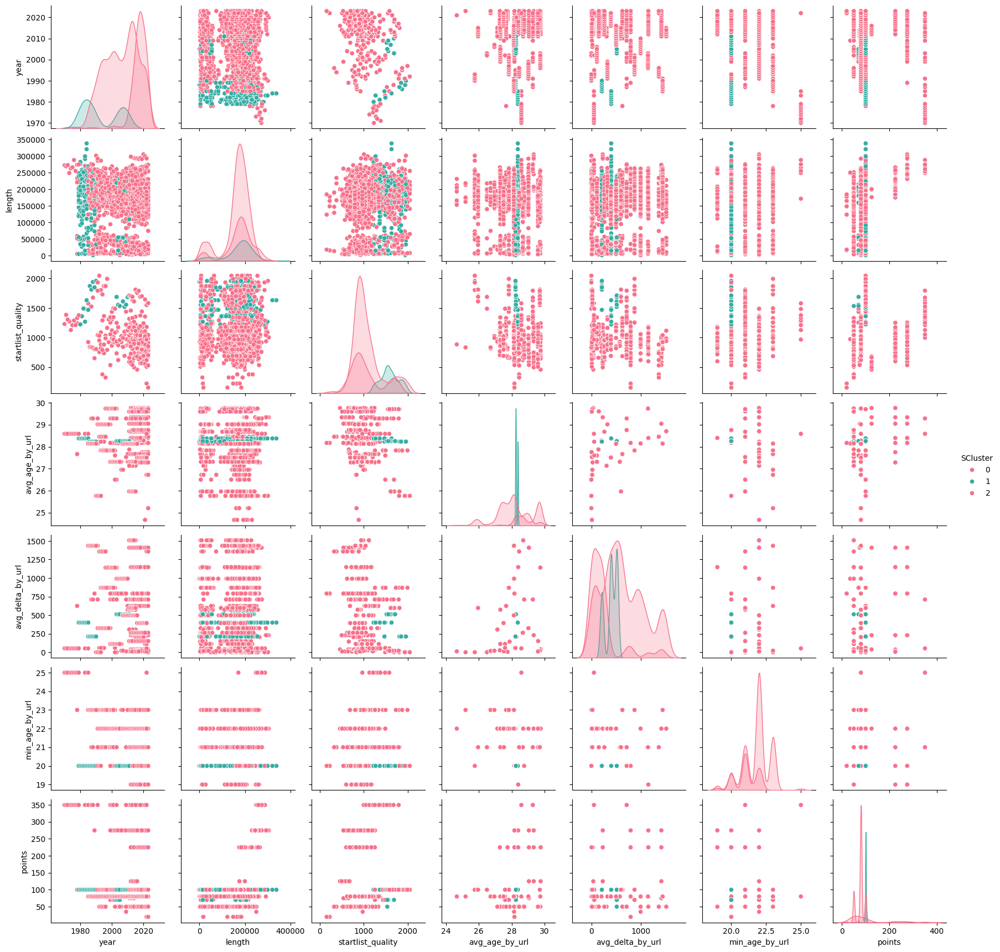

In [51]:
spect_clustering = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
labels = spect_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'SCluster', labels)

Note: Spectral clustering detects isolated points for stages with KNN

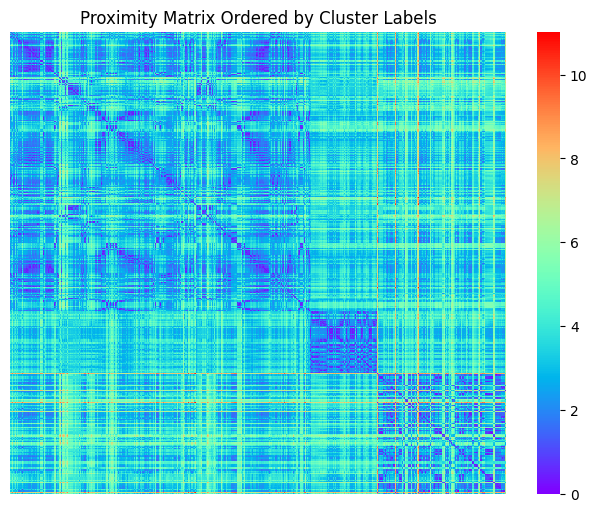

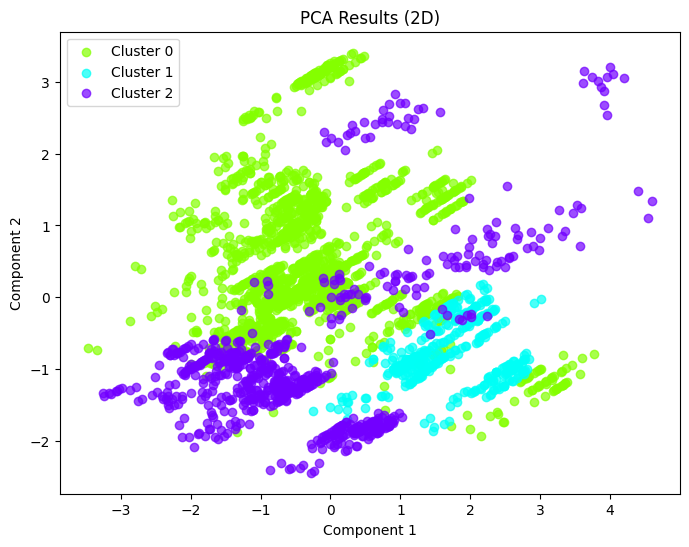

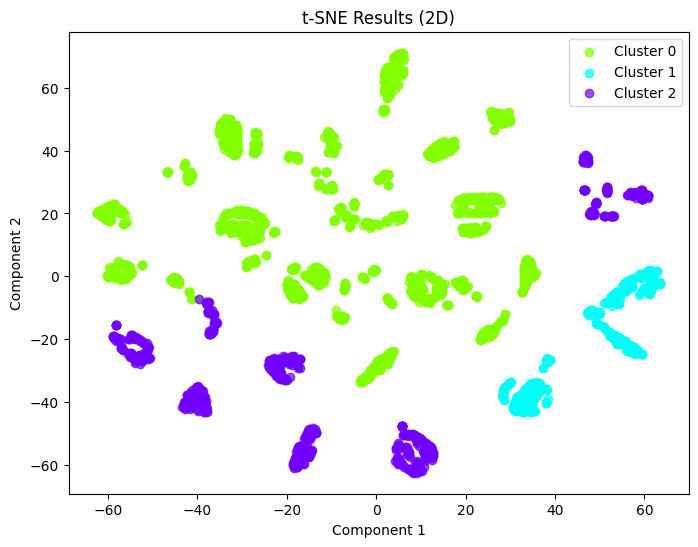

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


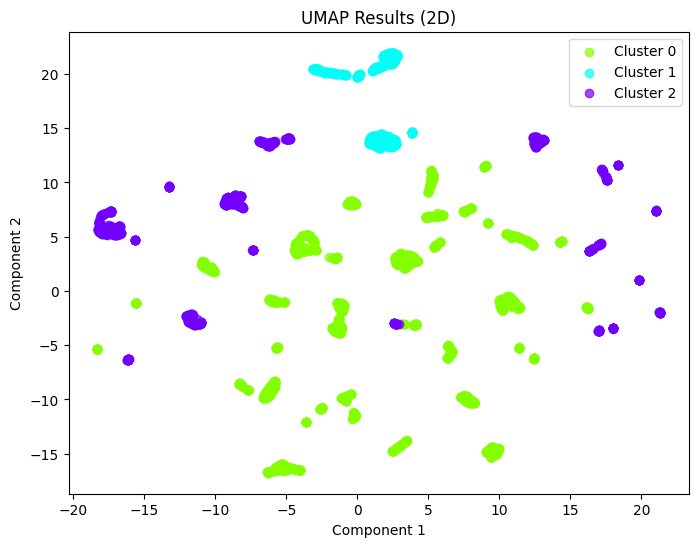

In [52]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

## DBscan

### Cyclists

In [53]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
dst_matrix_euclid_cyclists = squareform(dst_matrix_euclid_cyclists)
ks = [2*real_cyclists_df.shape[1], pow(2,real_cyclists_df.shape[1])]

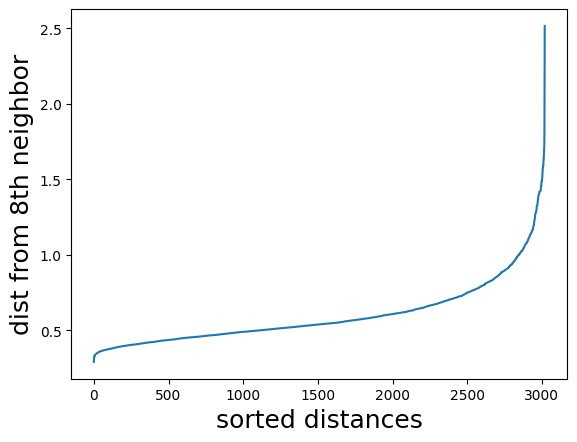

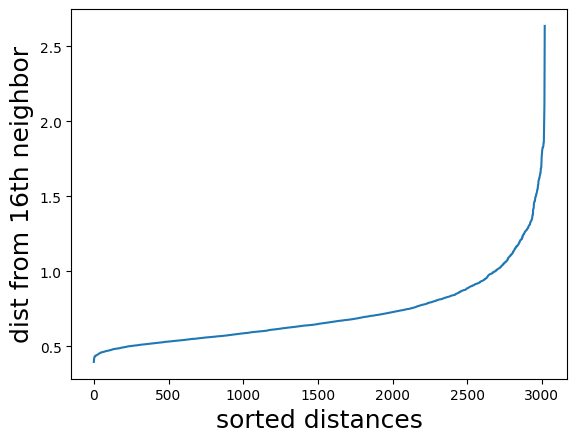

In [54]:
for dist, k in zip([dst_matrix_euclid_cyclists, dst_matrix_euclid_cyclists], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.50      12.0  1041.0
1   0.51       8.0   941.0
2   0.52       4.0   872.0
3   0.53       4.0   800.0
4   0.54       1.0   754.0
5   0.55       1.0   709.0
6   0.56       2.0   636.0
7   0.57       2.0   598.0
8   0.58       1.0   569.0
9   0.59       1.0   539.0
10  0.60       1.0   508.0
11  0.61       2.0   475.0
12  0.62       2.0   441.0
13  0.63       2.0   419.0
14  0.64       2.0   388.0
15  0.65       1.0   371.0
16  0.66       1.0   360.0
17  0.67       1.0   332.0
18  0.68       1.0   319.0
19  0.69       1.0   307.0
20  0.70       1.0   284.0
21  0.71       1.0   269.0
22  0.72       1.0   262.0
23  0.73       1.0   245.0
24  0.74       1.0   237.0
25  0.75       1.0   220.0
26  0.76       1.0   202.0
27  0.77       1.0   196.0
28  0.78       1.0   178.0
29  0.79       2.0   169.0
30  0.80       2.0   161.0
31  0.81       3.0   144.0
32  0.82       2.0   134.0
33  0.83       2.0   131.0
34  0.84       2.0   120.0
35  0.85       2.0   111.0
3

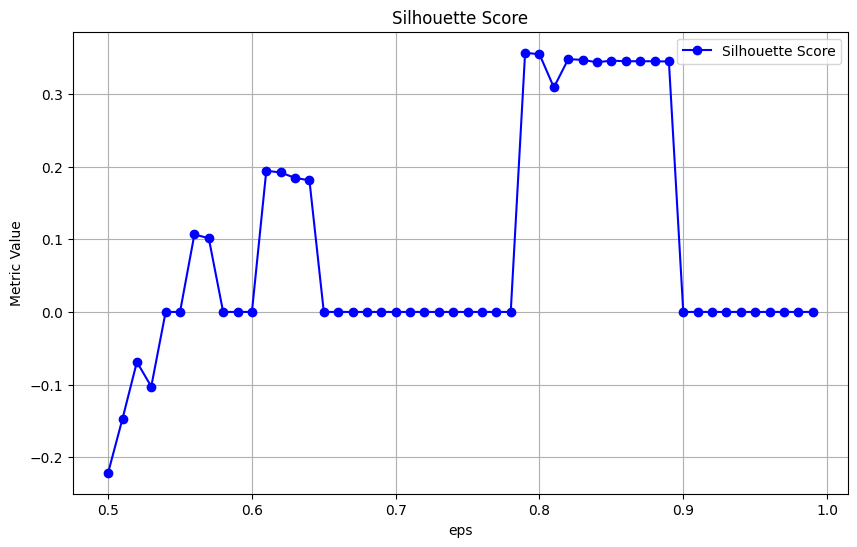

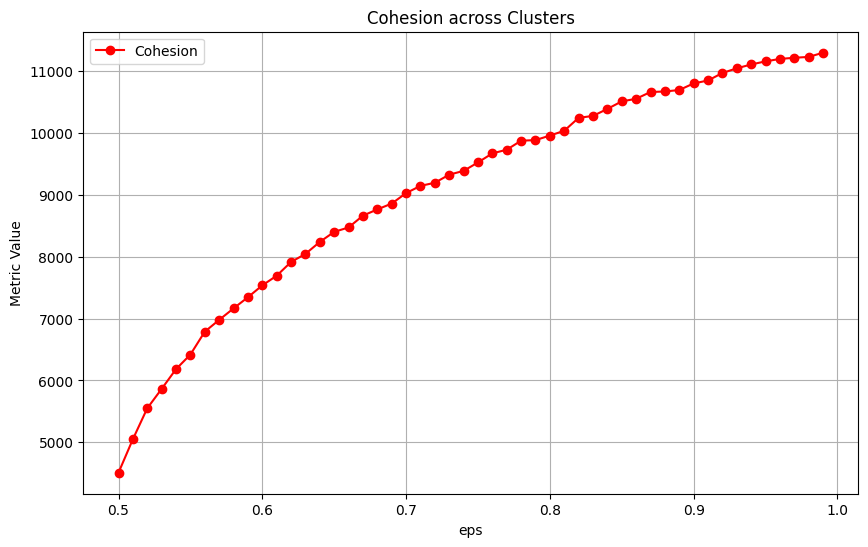

     eps  Clusters   Noise
0   0.50       4.0  2065.0
1   0.51       4.0  1935.0
2   0.52       2.0  1789.0
3   0.53       3.0  1686.0
4   0.54       3.0  1607.0
5   0.55       3.0  1489.0
6   0.56       1.0  1374.0
7   0.57       1.0  1276.0
8   0.58       1.0  1212.0
9   0.59       2.0  1101.0
10  0.60       2.0  1027.0
11  0.61       2.0   935.0
12  0.62       2.0   871.0
13  0.63       2.0   791.0
14  0.64       2.0   721.0
15  0.65       2.0   689.0
16  0.66       2.0   647.0
17  0.67       1.0   585.0
18  0.68       1.0   535.0
19  0.69       1.0   504.0
20  0.70       1.0   474.0
21  0.71       1.0   448.0
22  0.72       1.0   419.0
23  0.73       1.0   395.0
24  0.74       1.0   373.0
25  0.75       1.0   356.0
26  0.76       1.0   332.0
27  0.77       1.0   315.0
28  0.78       1.0   301.0
29  0.79       1.0   285.0
30  0.80       1.0   267.0
31  0.81       1.0   248.0
32  0.82       1.0   235.0
33  0.83       1.0   225.0
34  0.84       1.0   217.0
35  0.85       1.0   206.0
3

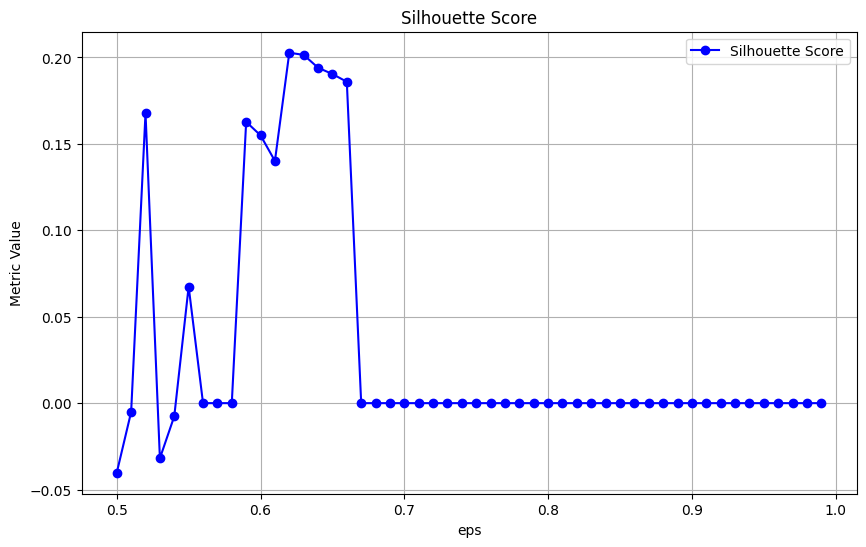

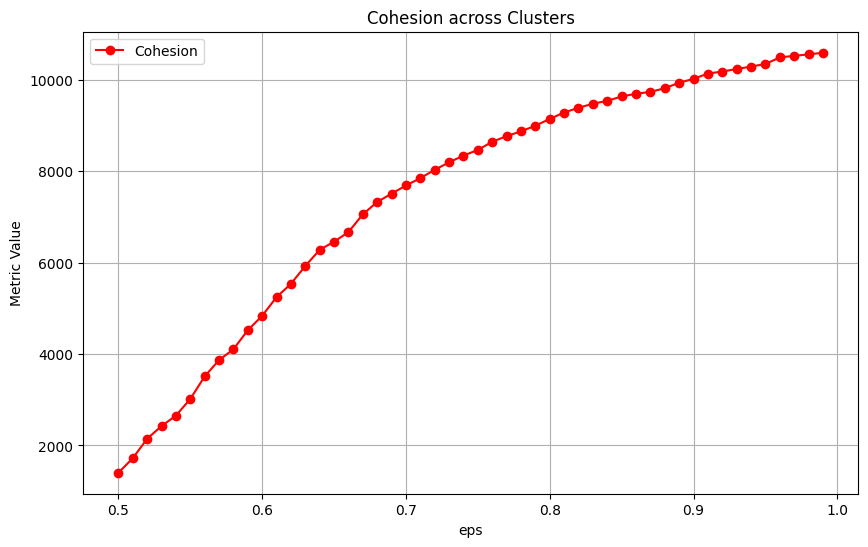

In [55]:
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), 2*real_cyclists_df.shape[1])
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), pow(2,real_cyclists_df.shape[1]))

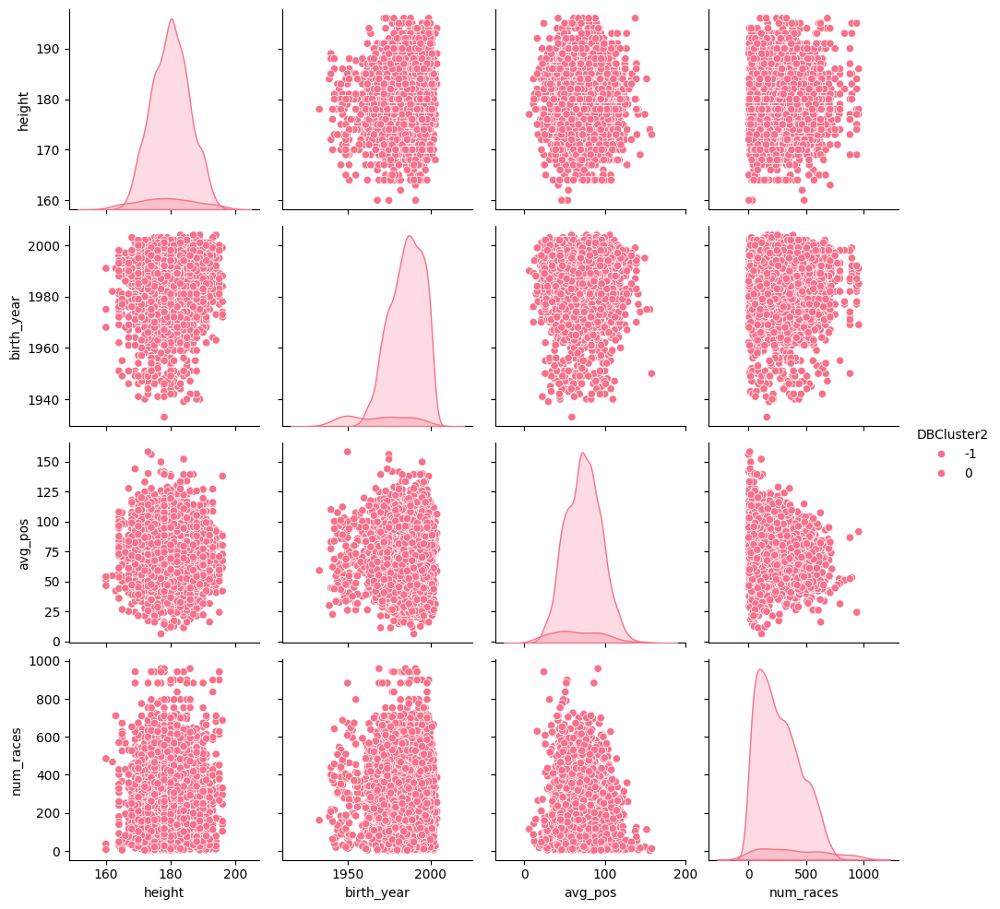

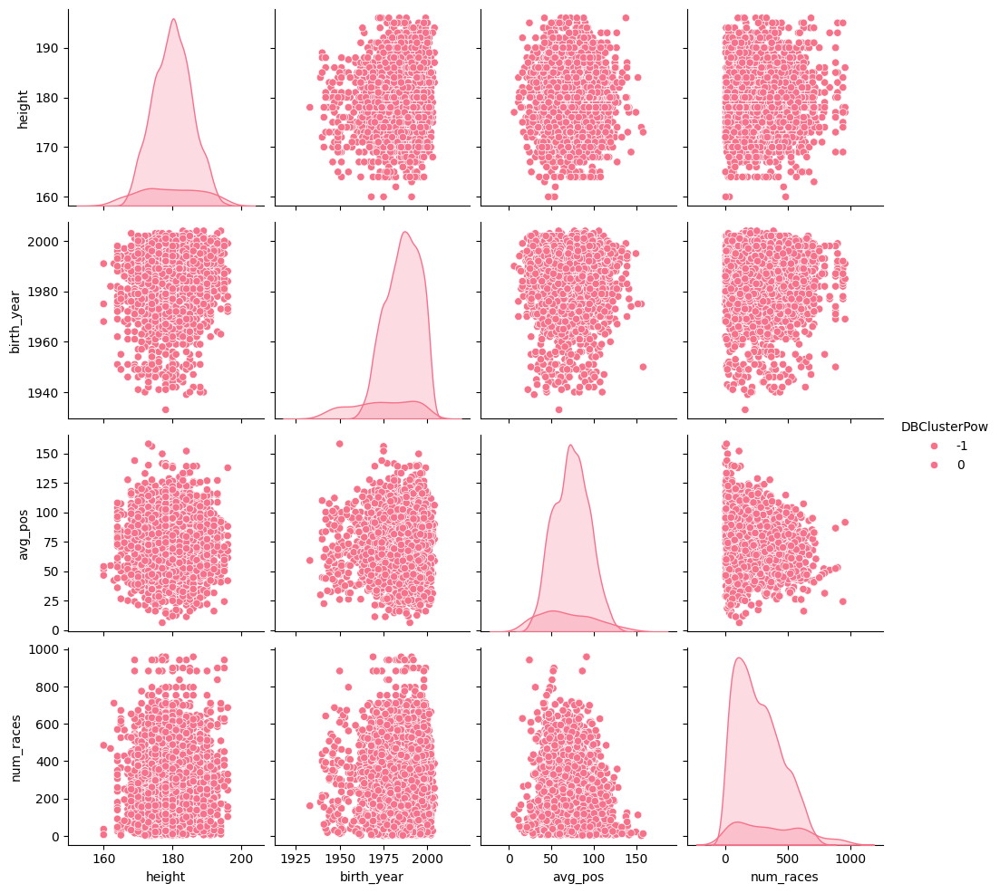

In [56]:
dbscan = DBSCAN(eps=0.7, min_samples=2*real_cyclists_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=0.7, min_samples=pow(2,real_cyclists_df.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBClusterPow', labels2)

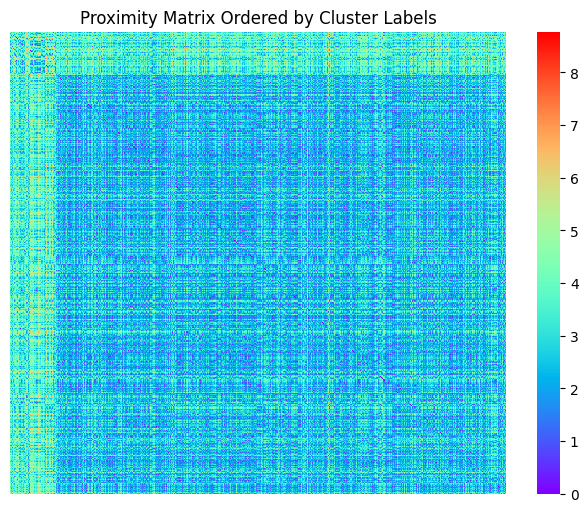

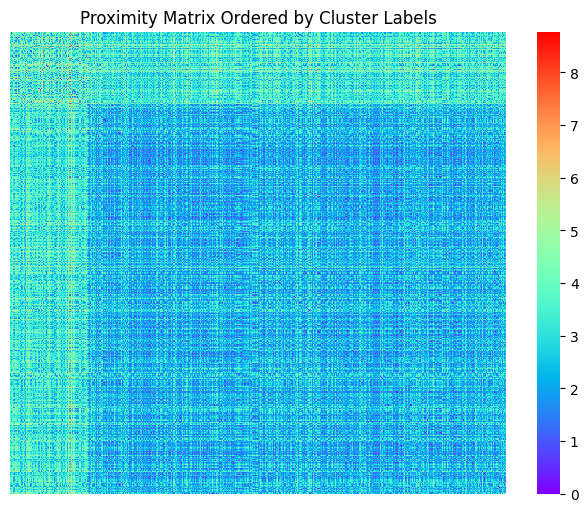

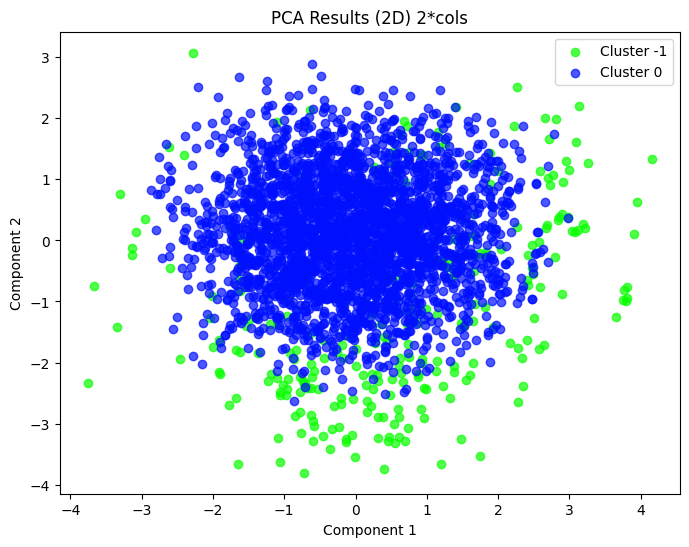

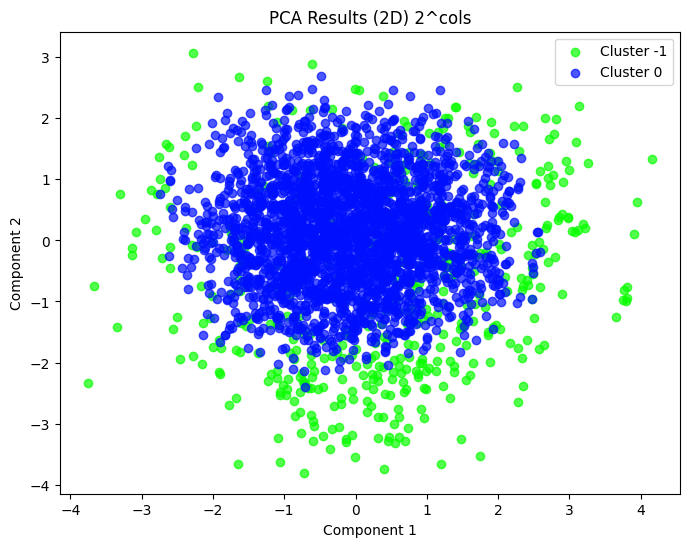

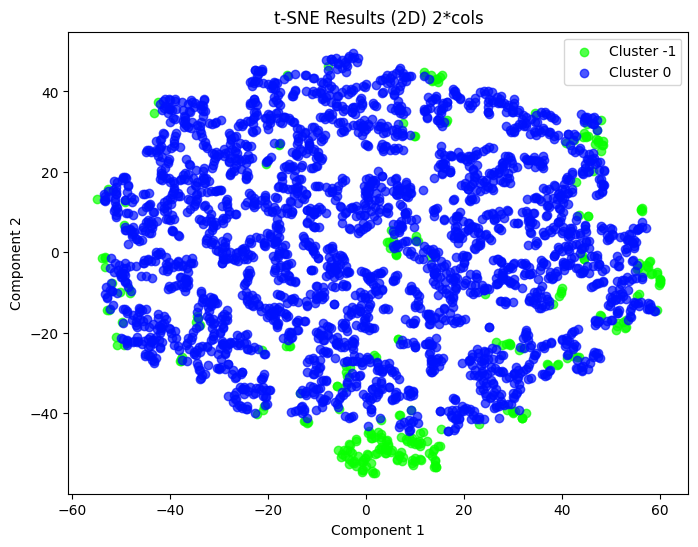

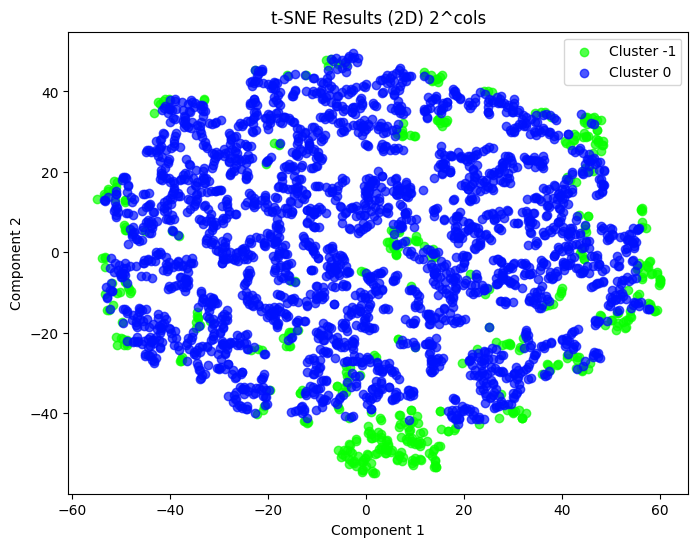

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


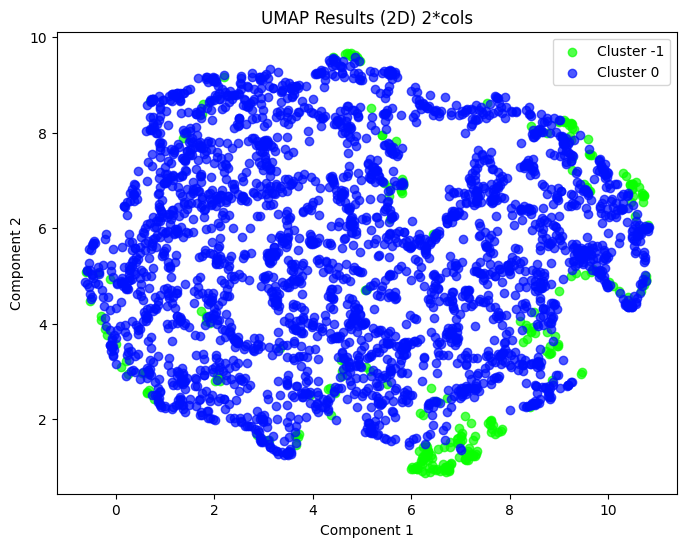

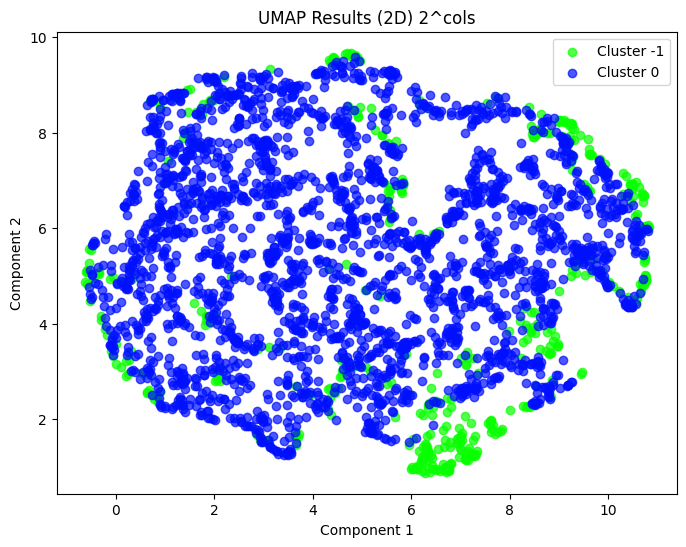

In [57]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels1)
clustering.similarity_matrix(real_cyclists_df, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Stages

In [58]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
dst_matrix_euclid_stages = squareform(dst_matrix_euclid_stages)
ks = [real_stages_df.shape[1] * 2, pow(2, real_stages_df.shape[1])]

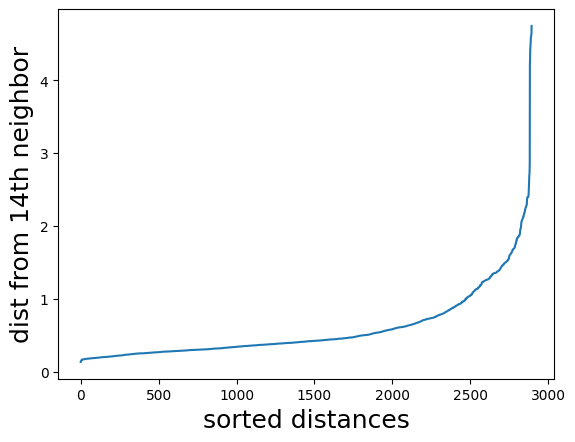

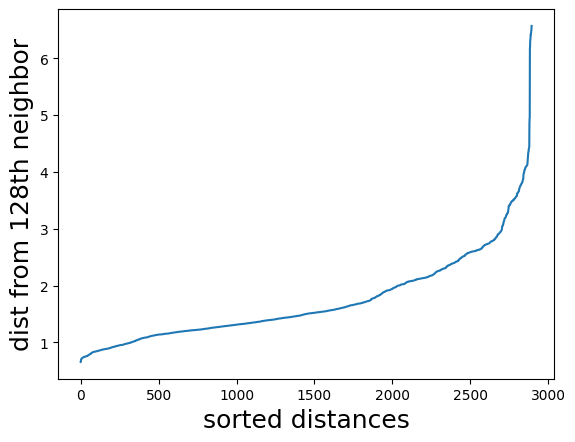

In [59]:
for dist, k in zip([dst_matrix_euclid_stages, dst_matrix_euclid_stages], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters  Noise
0   0.80      34.0  366.0
1   0.81      34.0  365.0
2   0.82      34.0  363.0
3   0.83      33.0  363.0
4   0.84      33.0  363.0
..   ...       ...    ...
65  1.45      13.0  106.0
66  1.46      13.0  103.0
67  1.47      12.0  101.0
68  1.48      12.0   98.0
69  1.49      12.0   96.0

[70 rows x 3 columns]


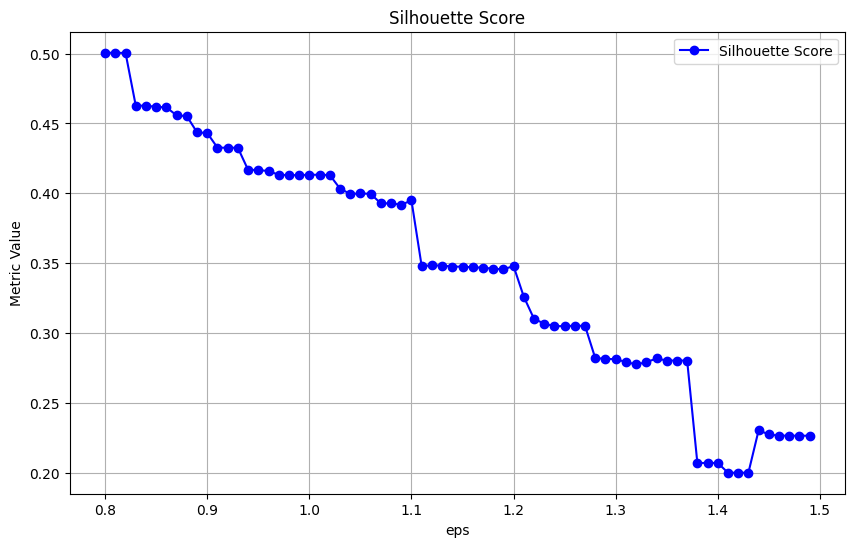

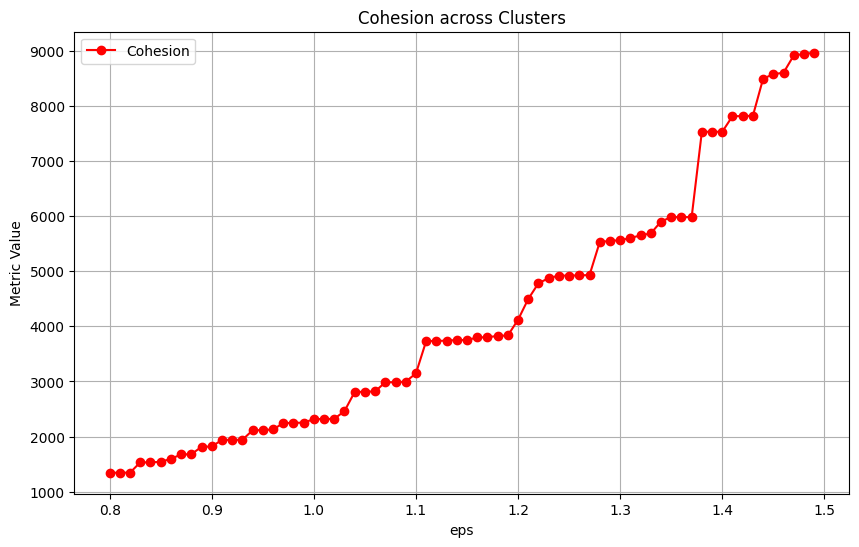

      eps  Clusters  Noise
0    2.00       1.0  221.0
1    2.01       1.0  220.0
2    2.02       1.0  207.0
3    2.03       1.0  207.0
4    2.04       1.0  207.0
..    ...       ...    ...
195  3.95       1.0   12.0
196  3.96       1.0   12.0
197  3.97       1.0   12.0
198  3.98       1.0   12.0
199  3.99       1.0   12.0

[200 rows x 3 columns]


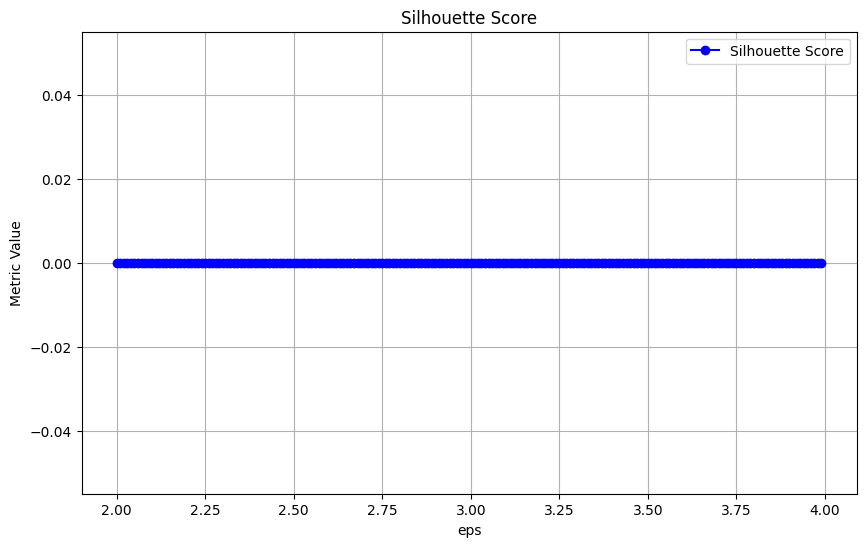

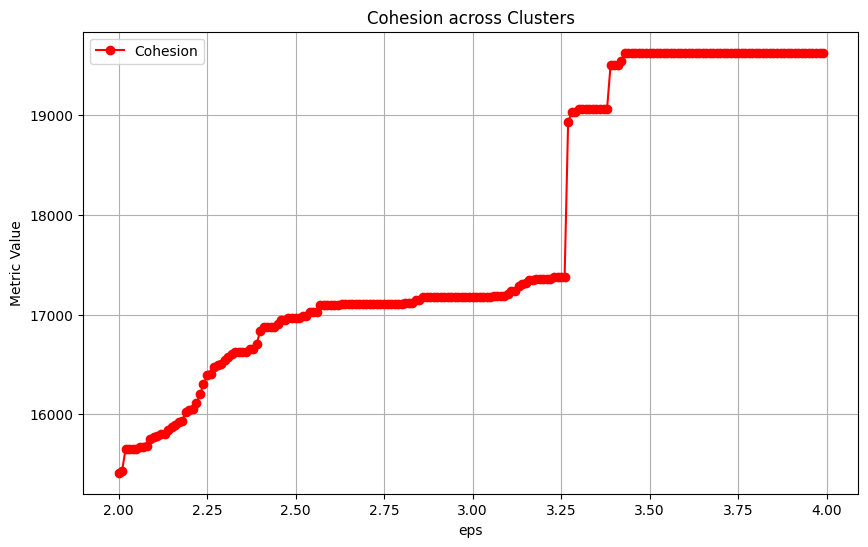

In [60]:
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(0.8, 1.5, 0.01), 2* real_stages_df.shape[1])
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(2, 4, 0.01), pow(2,real_stages_df.shape[1]))

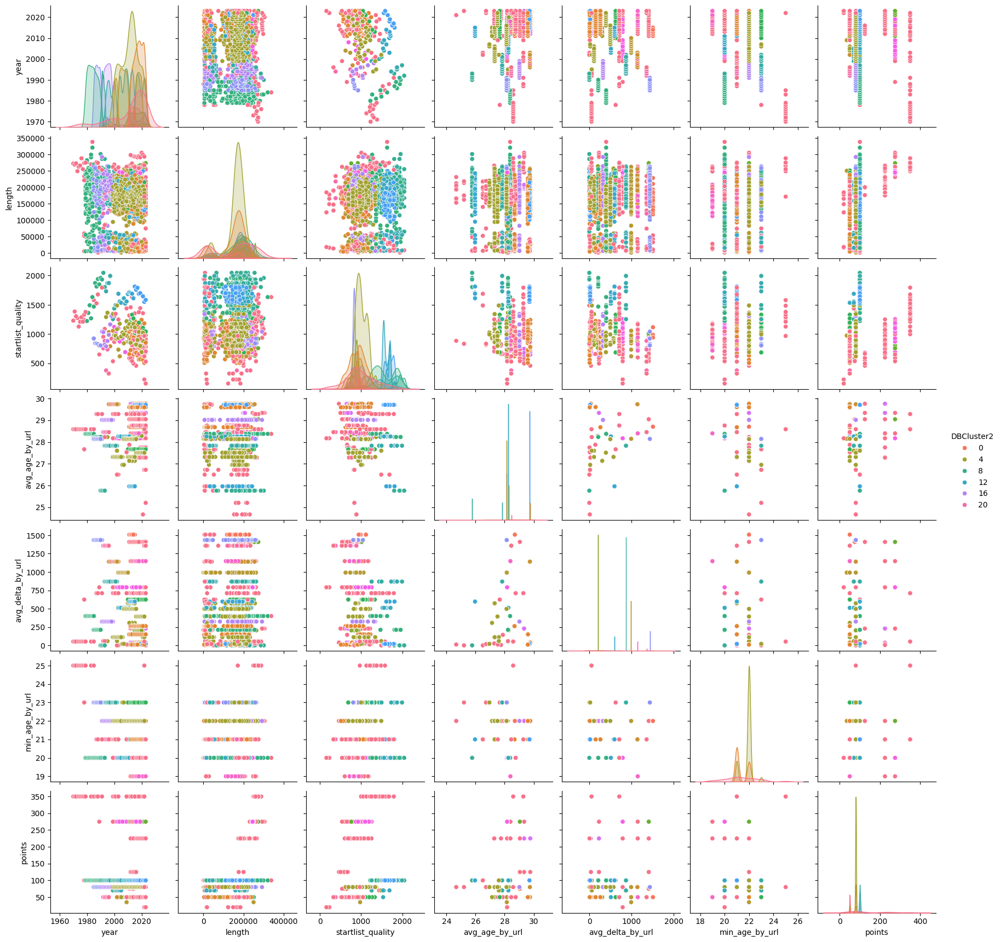

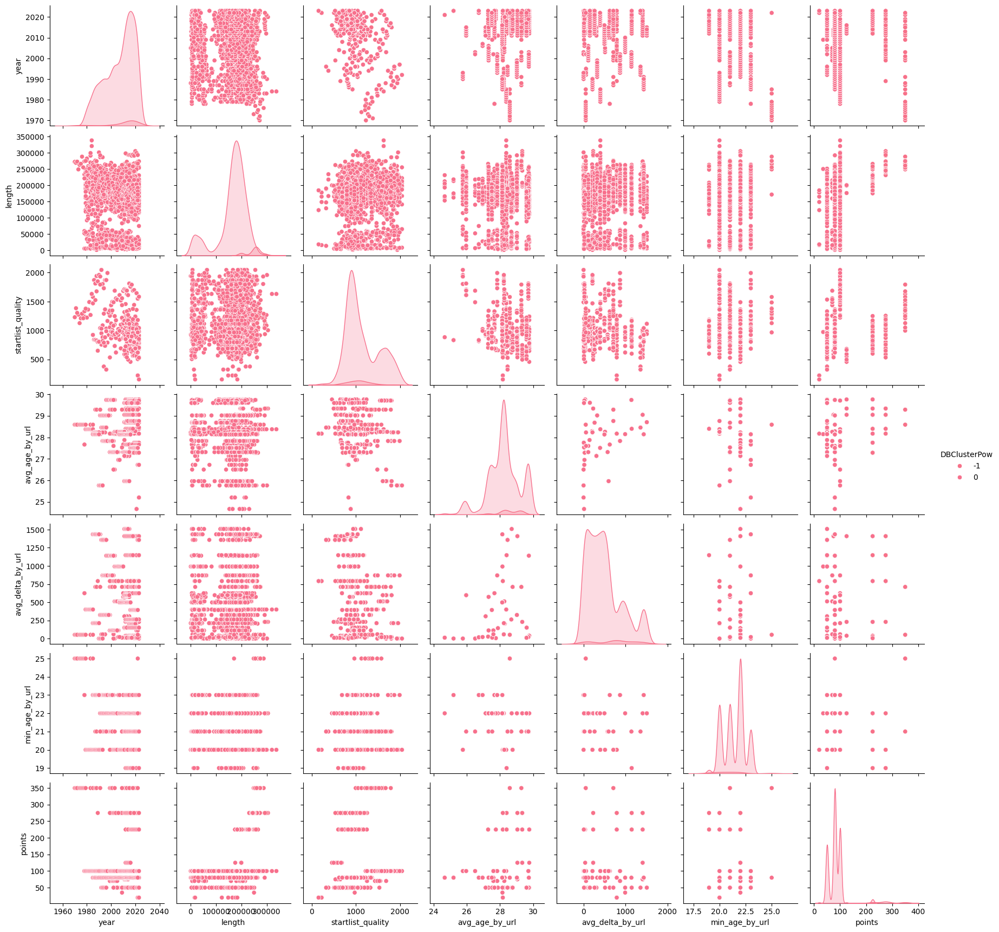

In [61]:
dbscan = DBSCAN(eps=1.1, min_samples=2*real_stages_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=3.1, min_samples=pow(2,real_stages_df.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBClusterPow', labels2)

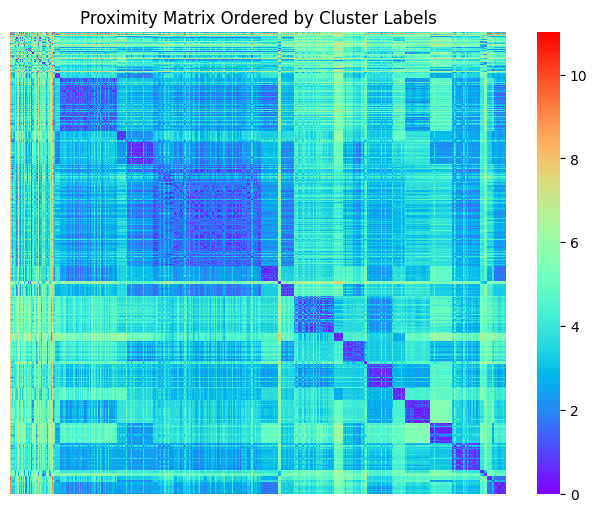

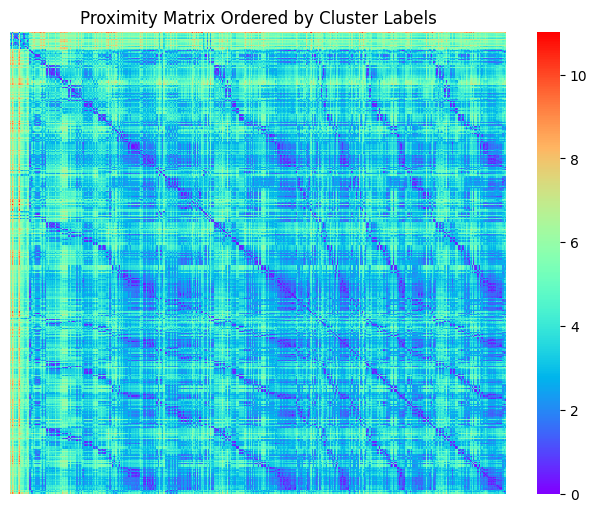

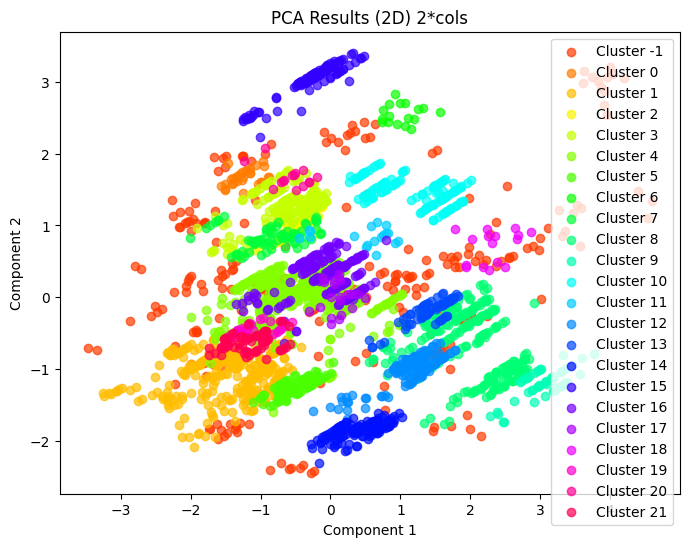

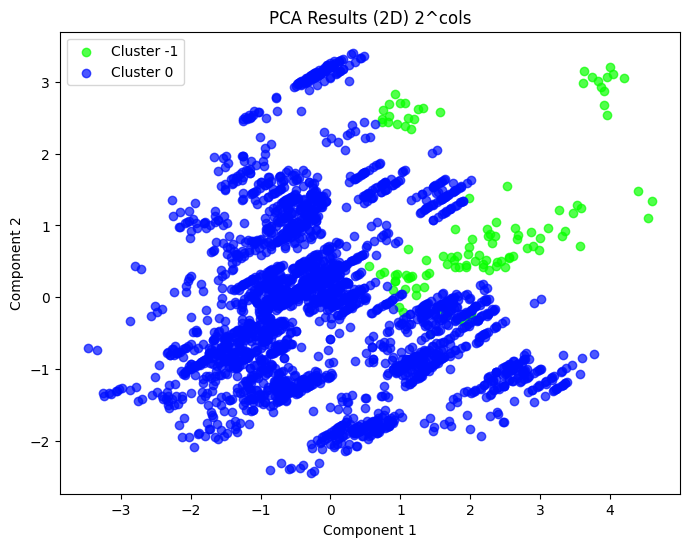

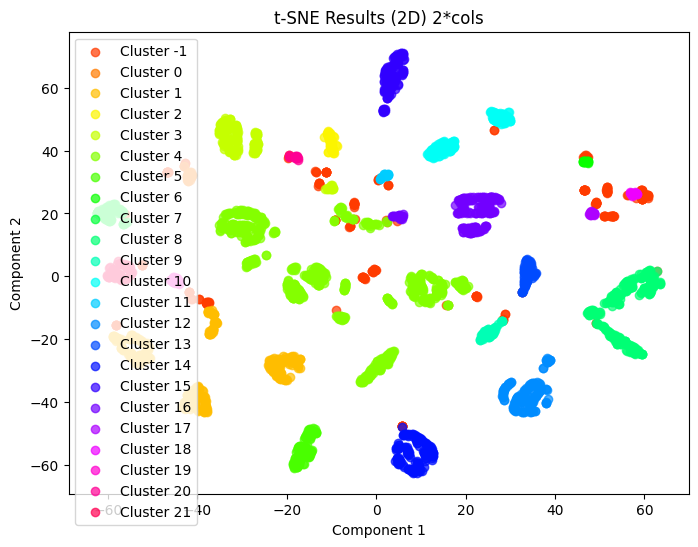

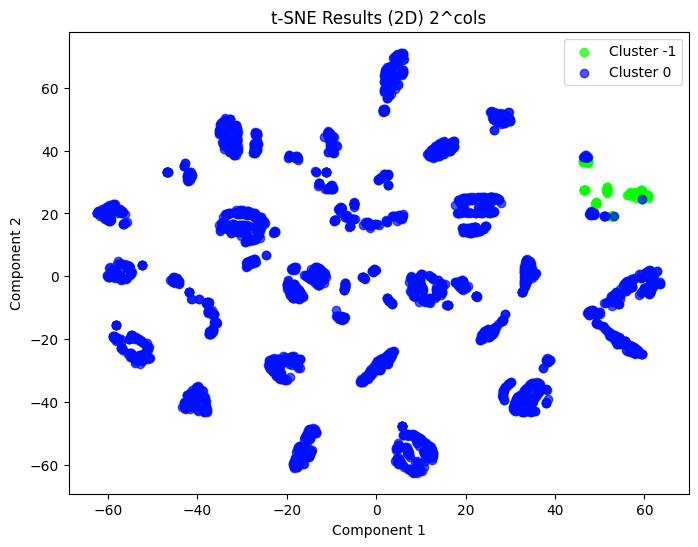

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


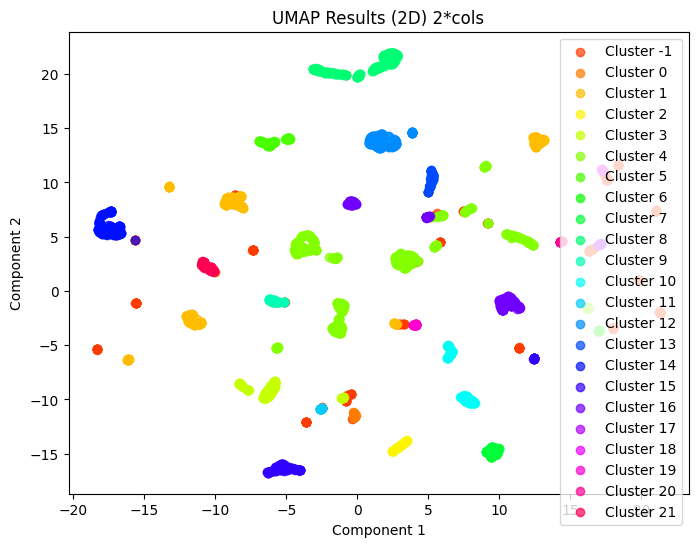

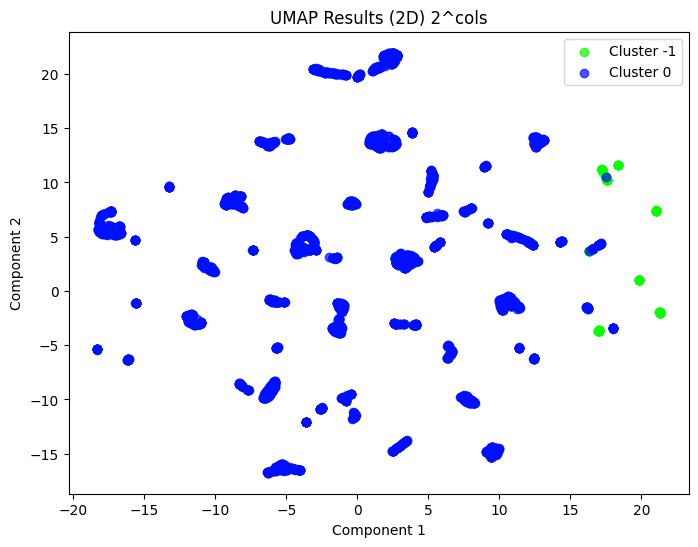

In [62]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels1)
clustering.similarity_matrix(real_stages_df, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics
Tuning according to https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/#:~:text=A%20value%20of%20MinPts%20%3D%202,largest%20to%20the%20smallest%20value.

### Optics Cyclists

Hyperparameters tuning

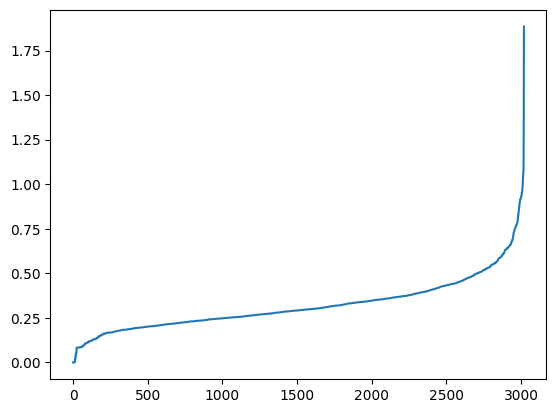

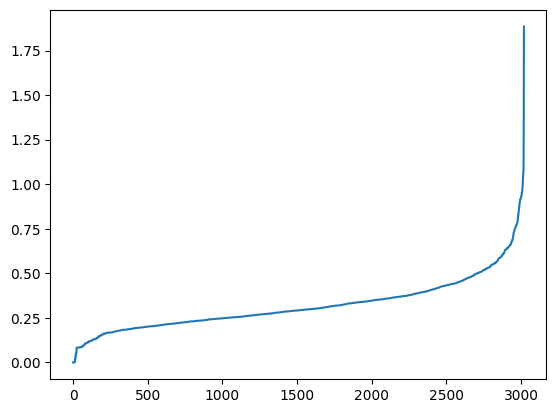

In [63]:
from sklearn.neighbors import NearestNeighbors
def knn_tune(df, samples):
    neighbors = NearestNeighbors(n_neighbors=samples)
    neighbors_fit = neighbors.fit(df)
    distances, indices = neighbors_fit.kneighbors(df)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    plt.plot(distances)
    plt.show()
knn_tune(real_cyclists_df, real_cyclists_df.shape[1]*2)
knn_tune(real_cyclists_df, pow(2,real_cyclists_df.shape[1]))   

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       1.0  3012.0
5   0.30       1.0  3011.0
6   0.31       1.0  3011.0
7   0.32       3.0  2981.0
8   0.33       6.0  2952.0
9   0.34       9.0  2903.0
10  0.35      14.0  2833.0
11  0.36      15.0  2746.0
12  0.37      13.0  2687.0
13  0.38      12.0  2860.0
14  0.39      14.0  2825.0
15  0.40      16.0  2849.0
16  0.41      11.0  2866.0
17  0.42       9.0  2904.0
18  0.43       9.0  2907.0
19  0.44      10.0  2920.0
20  0.45      10.0  2918.0
21  0.46      11.0  2904.0
22  0.47       9.0  2926.0
23  0.48       9.0  2925.0
24  0.49      11.0  2896.0
25  0.50       9.0  2926.0
26  0.51       8.0  2939.0
27  0.52       6.0  2961.0
28  0.53       7.0  2952.0
29  0.54       6.0  2961.0
30  0.55       8.0  2936.0
31  0.56       8.0  2936.0
32  0.57       8.0  2936.0
33  0.58       8.0  2936.0
34  0.59       8.0  2

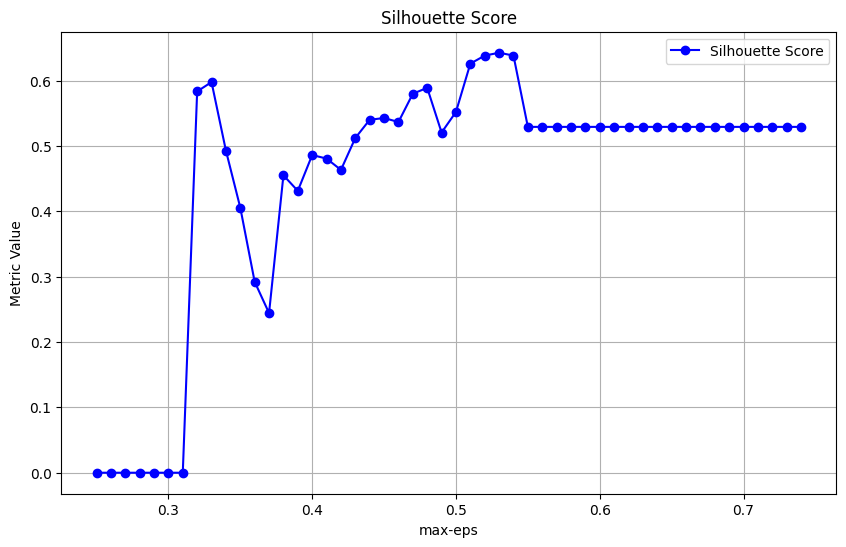

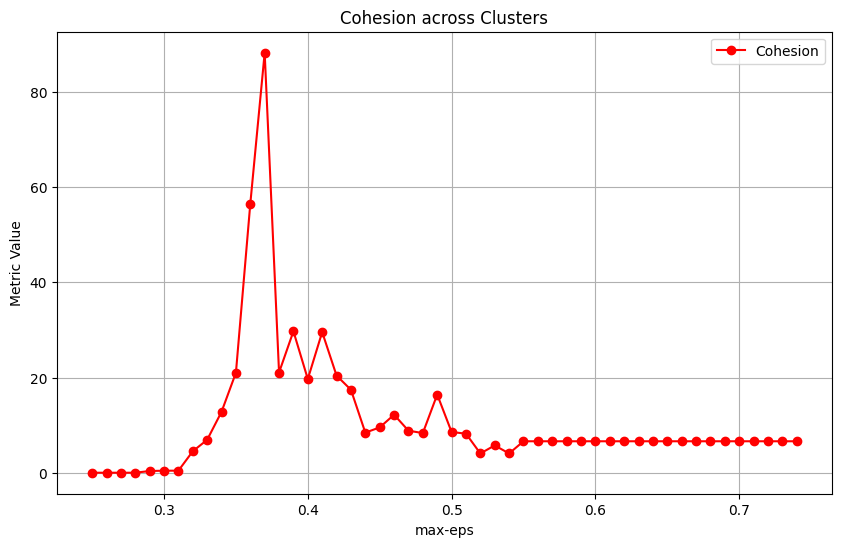

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       0.0  3020.0
5   0.30       0.0  3020.0
6   0.31       0.0  3020.0
7   0.32       0.0  3020.0
8   0.33       0.0  3020.0
9   0.34       0.0  3020.0
10  0.35       0.0  3020.0
11  0.36       0.0  3020.0
12  0.37       0.0  3020.0
13  0.38       0.0  3020.0
14  0.39       0.0  3020.0
15  0.40       0.0  3020.0
16  0.41       1.0  3003.0
17  0.42       1.0  2984.0
18  0.43       3.0  2940.0
19  0.44       3.0  2868.0
20  0.45       8.0  2708.0
21  0.46       8.0  2592.0
22  0.47       2.0  2478.0
23  0.48       1.0  2381.0
24  0.49       1.0  2261.0
25  0.50       2.0  2098.0
26  0.51       1.0  3003.0
27  0.52       1.0  1814.0
28  0.53       1.0  1716.0
29  0.54       1.0  1635.0
30  0.55       1.0  1515.0
31  0.56       1.0  1374.0
32  0.57       1.0  1277.0
33  0.58       1.0  1213.0
34  0.59       1.0  1

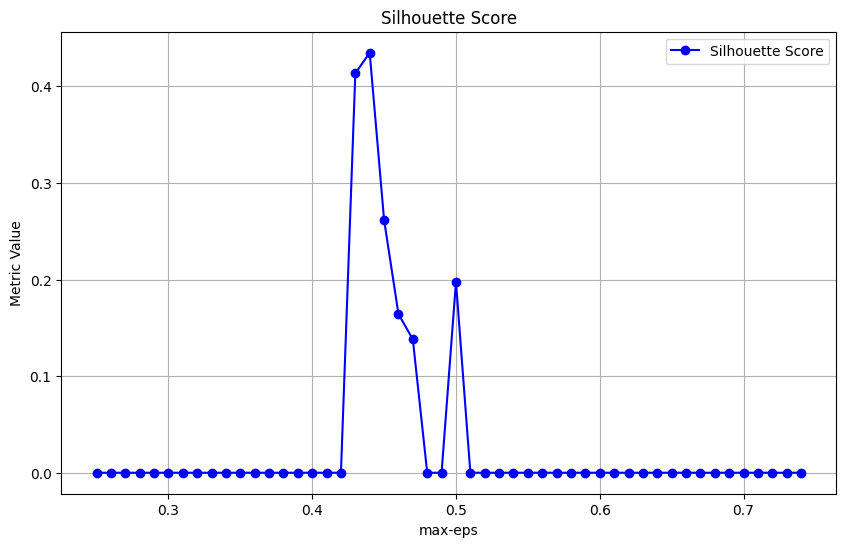

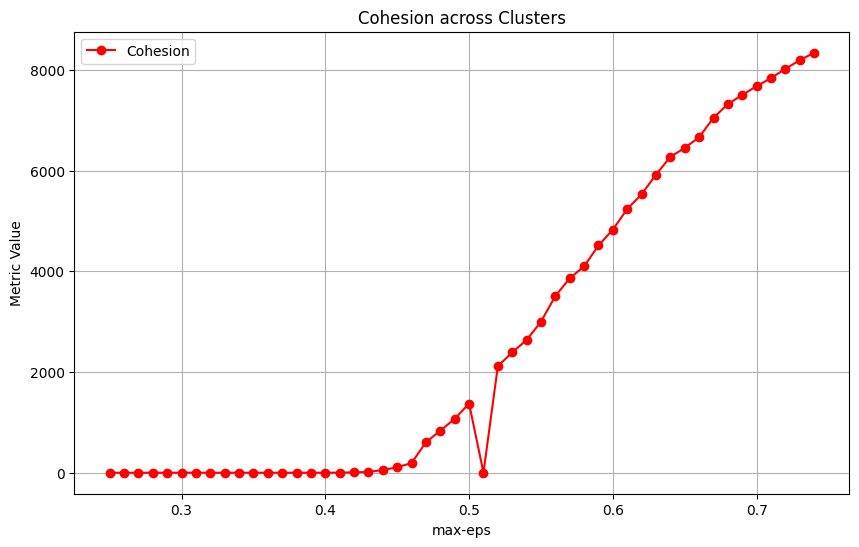

In [64]:
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01), 2*real_cyclists_df.shape[1])
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01), pow(2,real_cyclists_df.shape[1]))

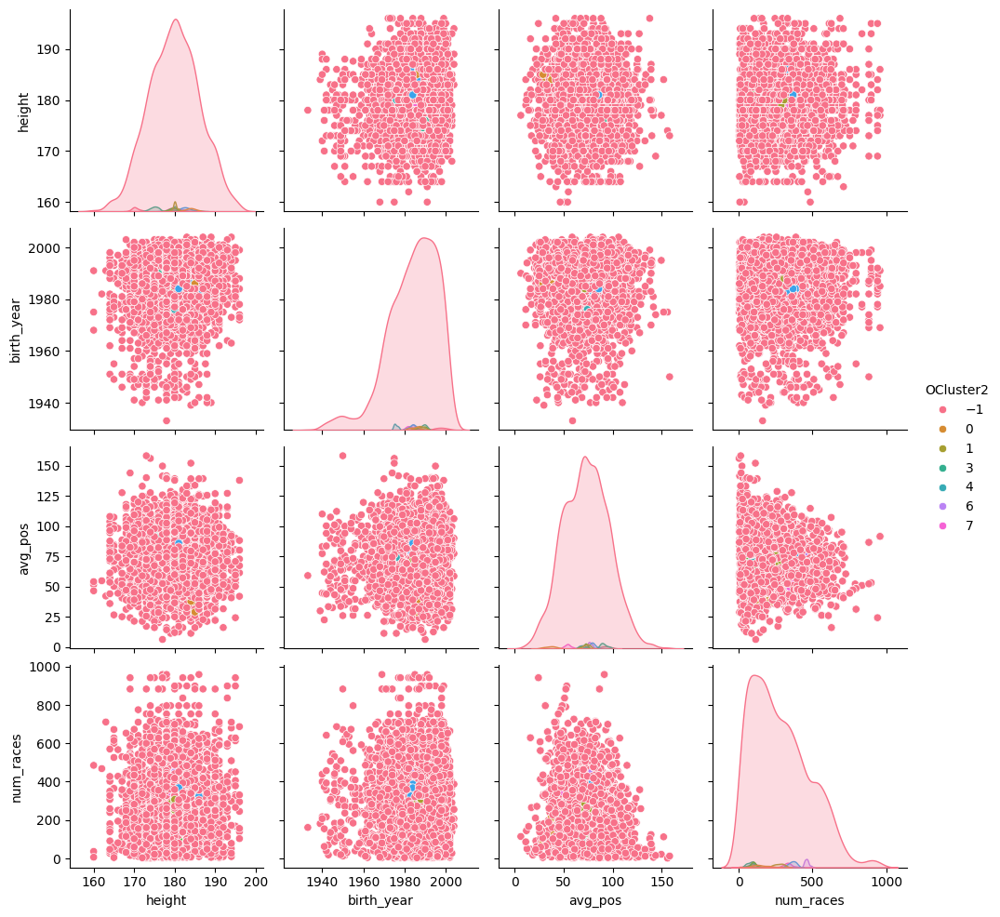

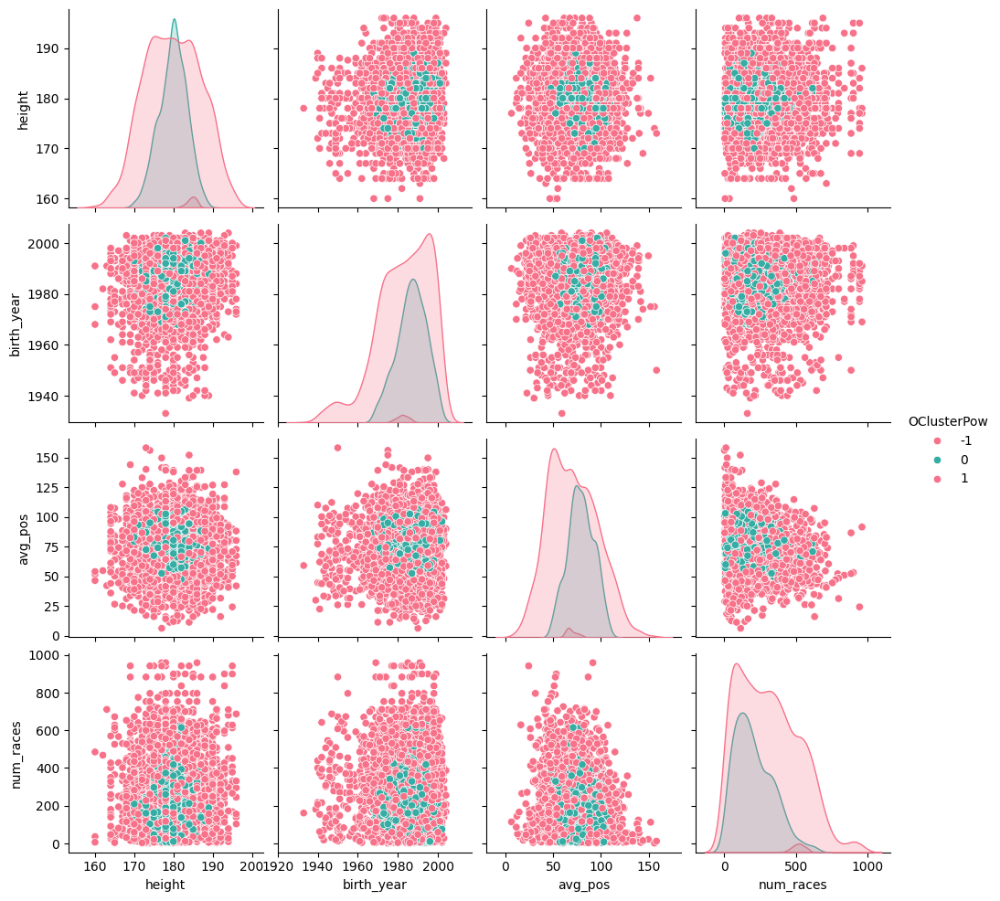

In [65]:
optics = OPTICS(max_eps=0.5, min_samples=2*real_cyclists_df.shape[1], metric='euclidean')
optics.fit(real_cyclists_df.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.5, min_samples=pow(2,real_cyclists_df.shape[1]), metric='euclidean')
optics.fit(real_cyclists_df.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OClusterPow', labels2)

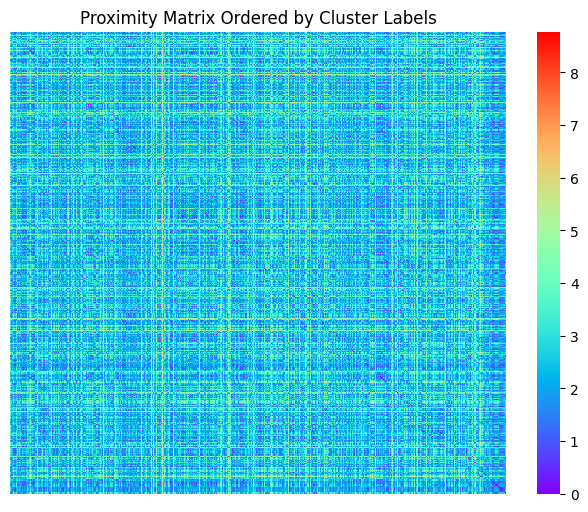

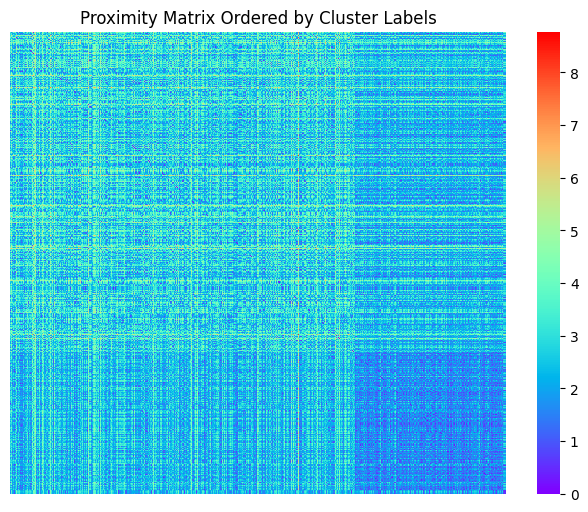

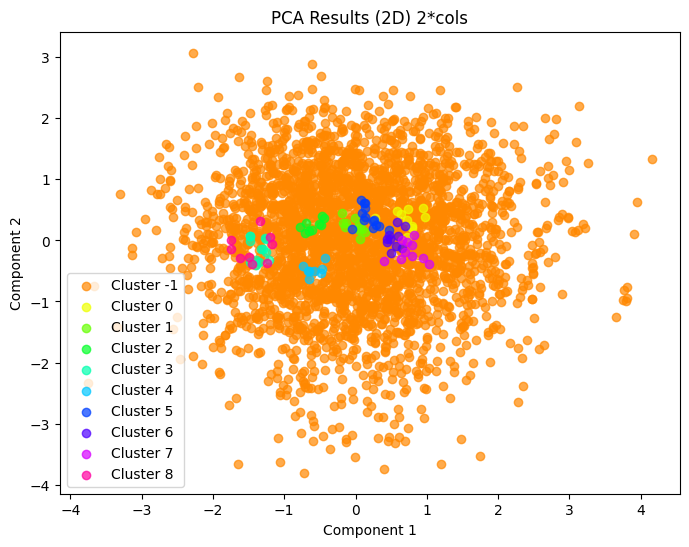

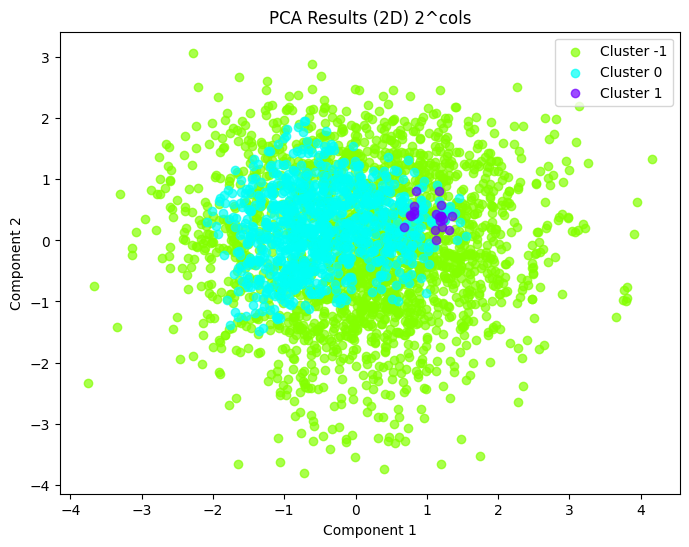

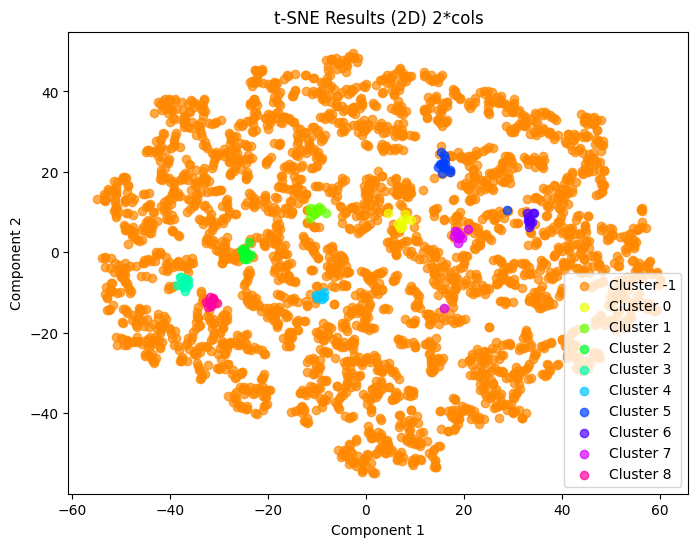

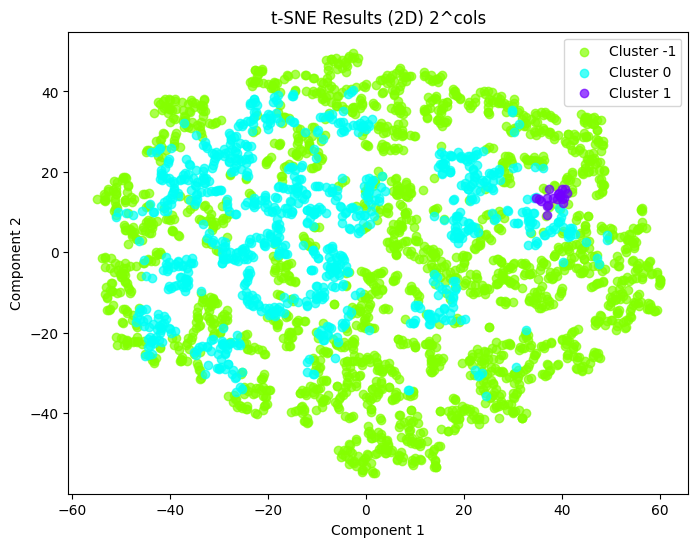

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


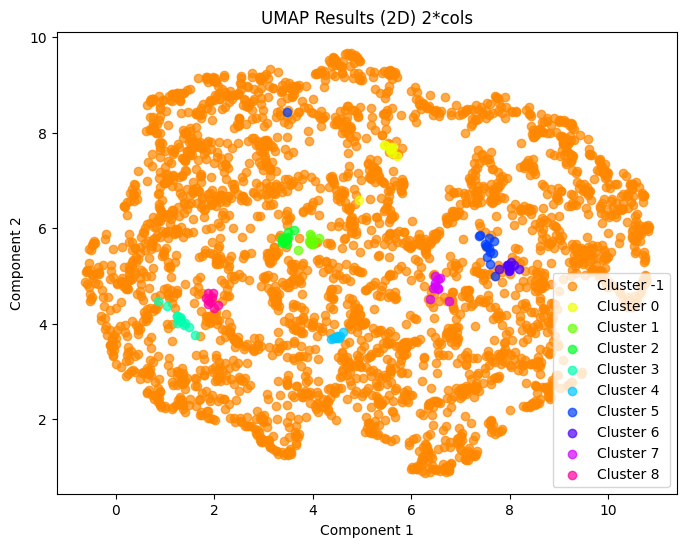

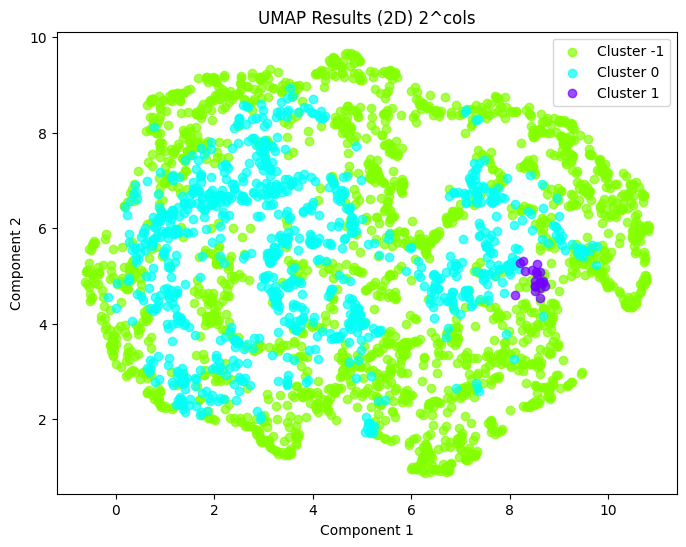

In [66]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels1)
clustering.similarity_matrix(real_cyclists_df, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics Stages

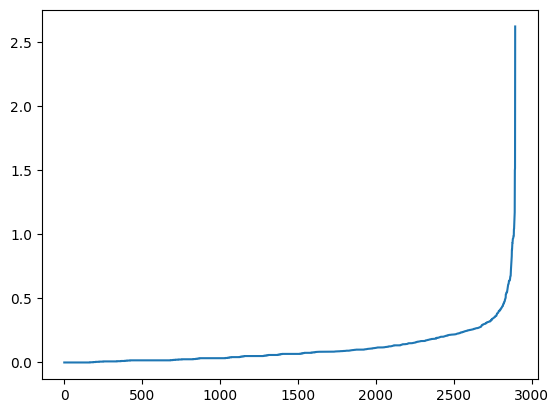

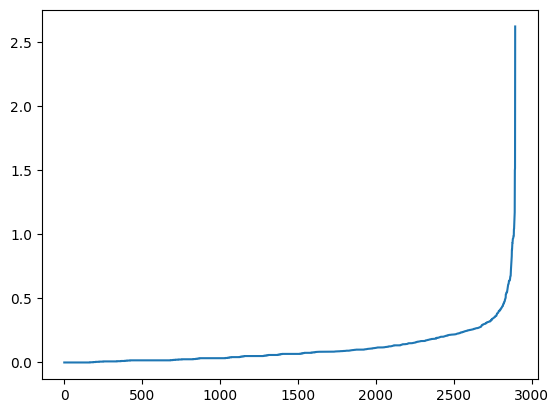

In [67]:
knn_tune(real_stages_df, 2*real_stages_df.shape[1])
knn_tune(real_stages_df, pow(2,real_stages_df.shape[1]))

Results for different eps values:
     eps  Clusters   Noise
0   0.30      27.0  2055.0
1   0.31      30.0  1977.0
2   0.32      29.0  1974.0
3   0.33      31.0  1943.0
4   0.34      31.0  1906.0
5   0.35      33.0  1955.0
6   0.36      35.0  1892.0
7   0.37      37.0  1853.0
8   0.38      36.0  1839.0
9   0.39      37.0  1825.0
10  0.40      39.0  1779.0
11  0.41      41.0  1734.0
12  0.42      40.0  1793.0
13  0.43      42.0  1755.0
14  0.44      41.0  1741.0
15  0.45      41.0  1737.0
16  0.46      41.0  1744.0
17  0.47      41.0  1743.0
18  0.48      41.0  1740.0
19  0.49      42.0  1724.0
20  0.50      42.0  1723.0
21  0.51      42.0  1722.0
22  0.52      42.0  1717.0
23  0.53      43.0  1699.0
24  0.54      43.0  1699.0
25  0.55      43.0  1696.0
26  0.56      44.0  1674.0
27  0.57      44.0  1668.0
28  0.58      44.0  1666.0
29  0.59      44.0  1663.0
30  0.60      44.0  1663.0
31  0.61      45.0  1647.0
32  0.62      46.0  1631.0
33  0.63      46.0  1631.0
34  0.64      47.0  1

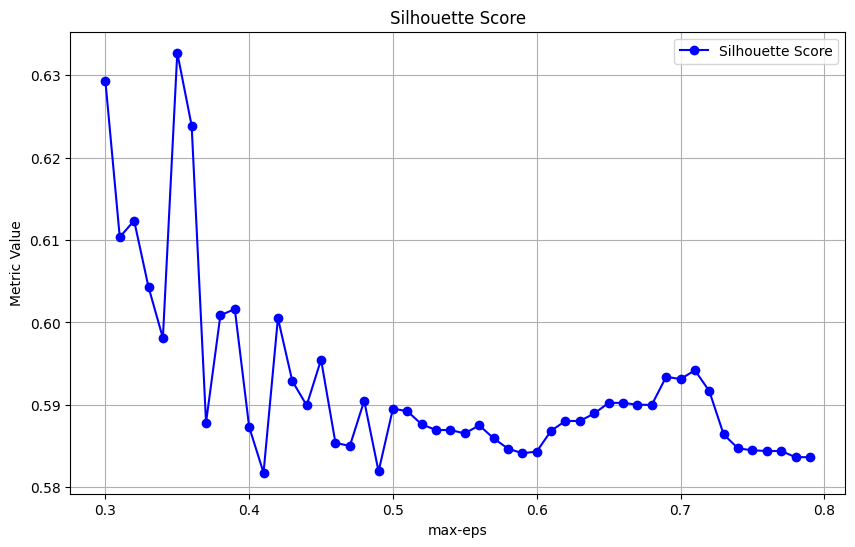

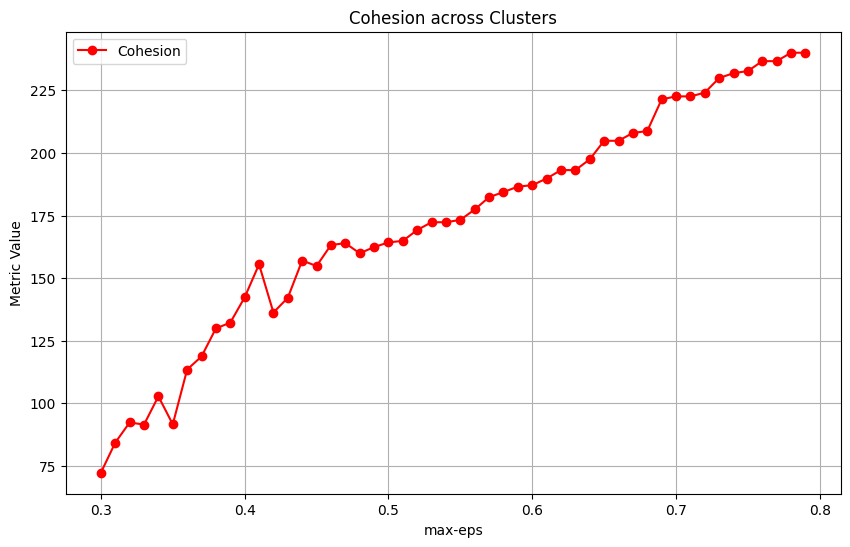

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.30       0.0  2895.0
1   0.31       0.0  2895.0
2   0.32       0.0  2895.0
3   0.33       0.0  2895.0
4   0.34       0.0  2895.0
5   0.35       0.0  2895.0
6   0.36       0.0  2895.0
7   0.37       0.0  2895.0
8   0.38       0.0  2895.0
9   0.39       0.0  2895.0
10  0.40       0.0  2895.0
11  0.41       0.0  2895.0
12  0.42       0.0  2895.0
13  0.43       0.0  2895.0
14  0.44       0.0  2895.0
15  0.45       0.0  2895.0
16  0.46       0.0  2895.0
17  0.47       0.0  2895.0
18  0.48       0.0  2895.0
19  0.49       0.0  2895.0
20  0.50       0.0  2895.0
21  0.51       0.0  2895.0
22  0.52       0.0  2895.0
23  0.53       0.0  2895.0
24  0.54       0.0  2895.0
25  0.55       0.0  2895.0
26  0.56       0.0  2895.0
27  0.57       0.0  2895.0
28  0.58       0.0  2895.0
29  0.59       0.0  2895.0
30  0.60       0.0  2895.0
31  0.61       0.0  2895.0
32  0.62       0.0  2895.0
33  0.63       0.0  2895.0
34  0.64       0.0  2

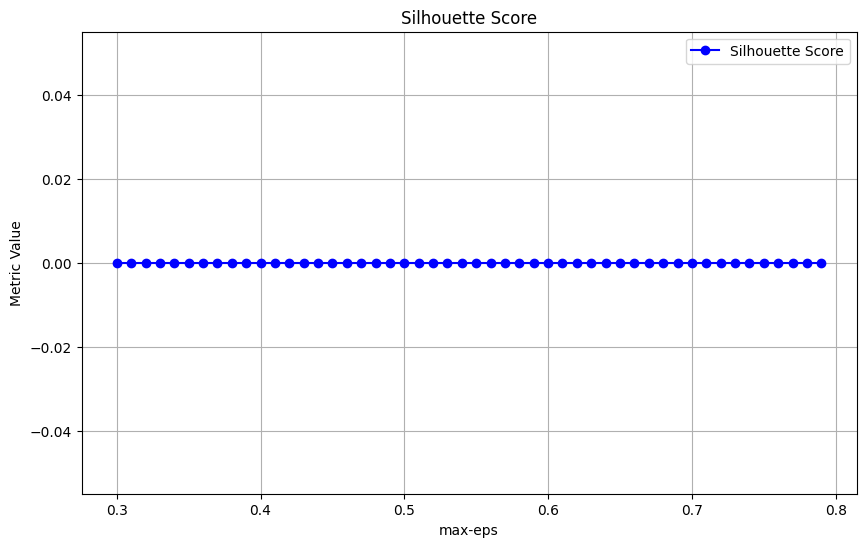

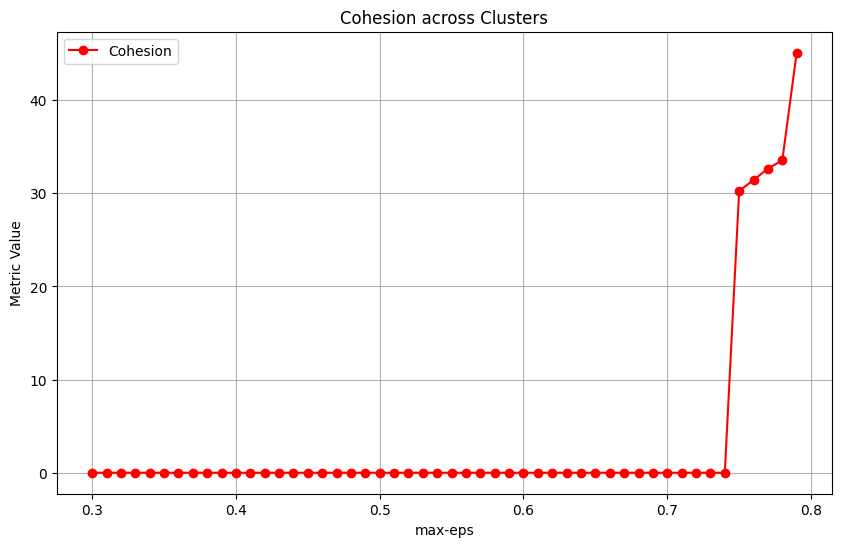

In [68]:
clustering.optics_tune(real_stages_df, np.arange(0.3, 0.8, 0.01), 2*real_stages_df.shape[1])
clustering.optics_tune(real_stages_df, np.arange(0.3, 0.8, 0.01), pow(2,real_stages_df.shape[1]))

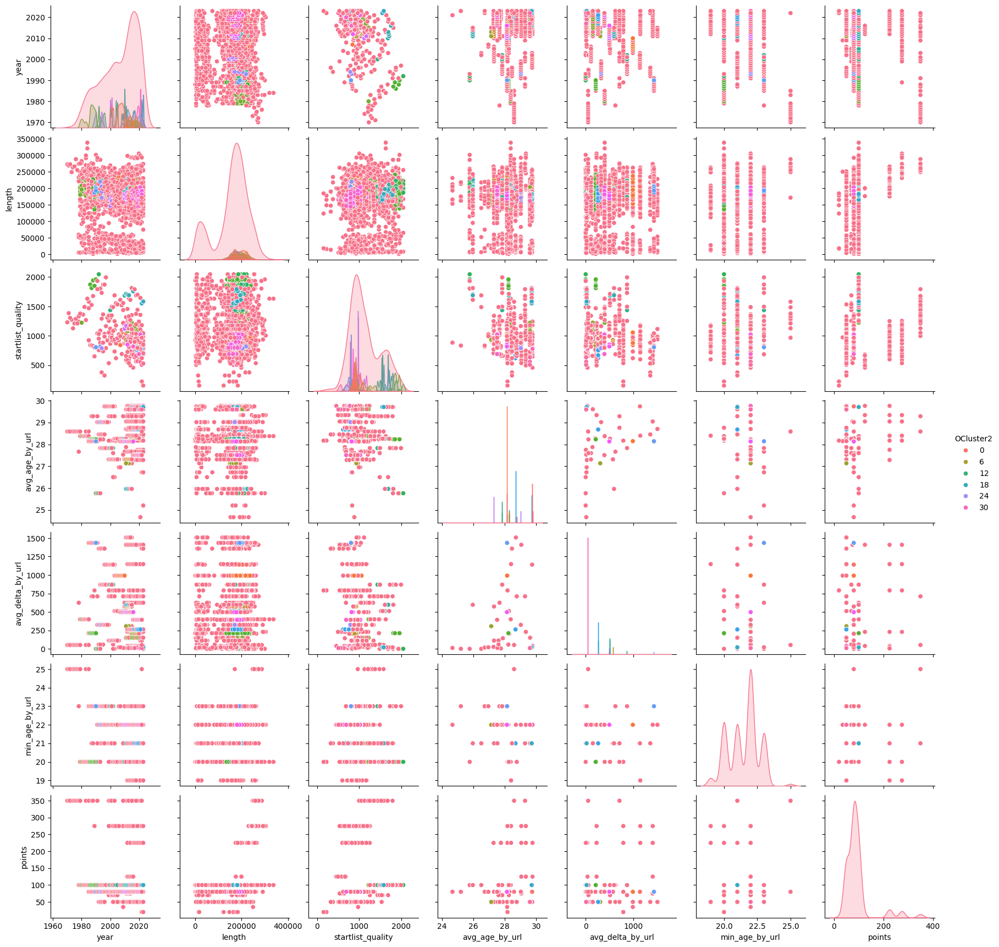

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


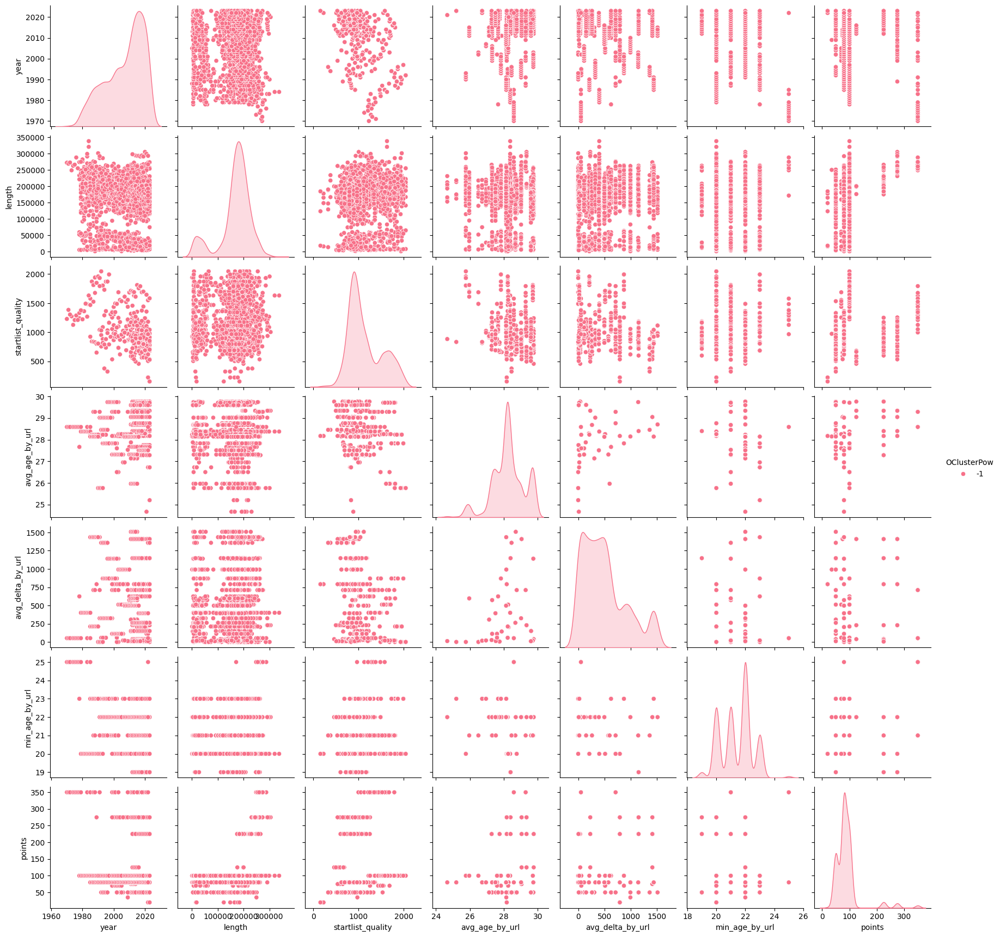

In [69]:
optics = OPTICS(max_eps=0.35, min_samples=2*real_stages_df.shape[1], metric='euclidean')
optics.fit(real_stages_df.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(stages, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.35, min_samples=pow(2,real_stages_df.shape[1]), metric='euclidean')
optics.fit(real_stages_df.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(stages, 'OClusterPow', labels2)

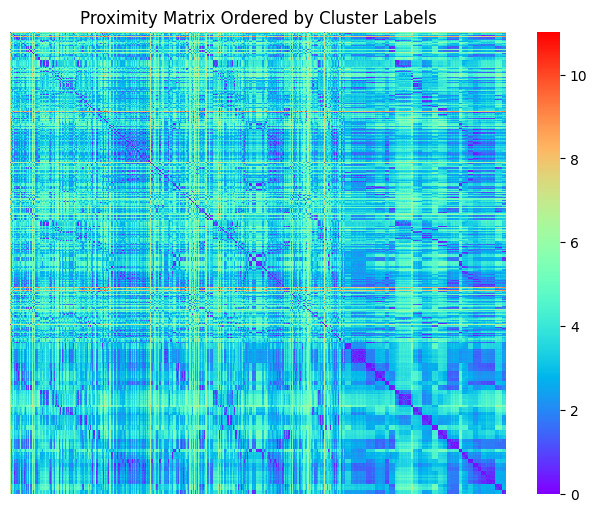

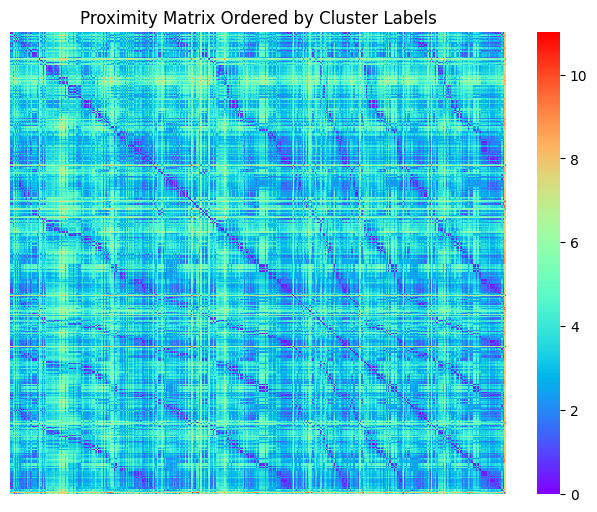

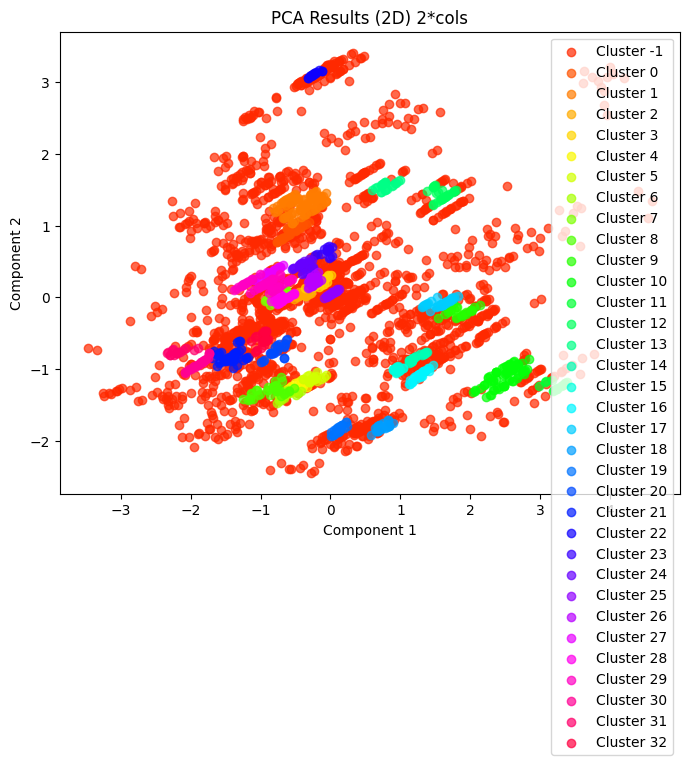

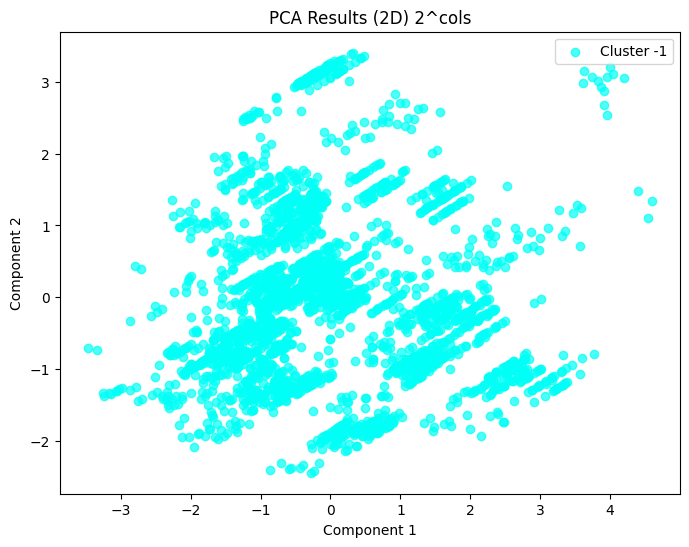

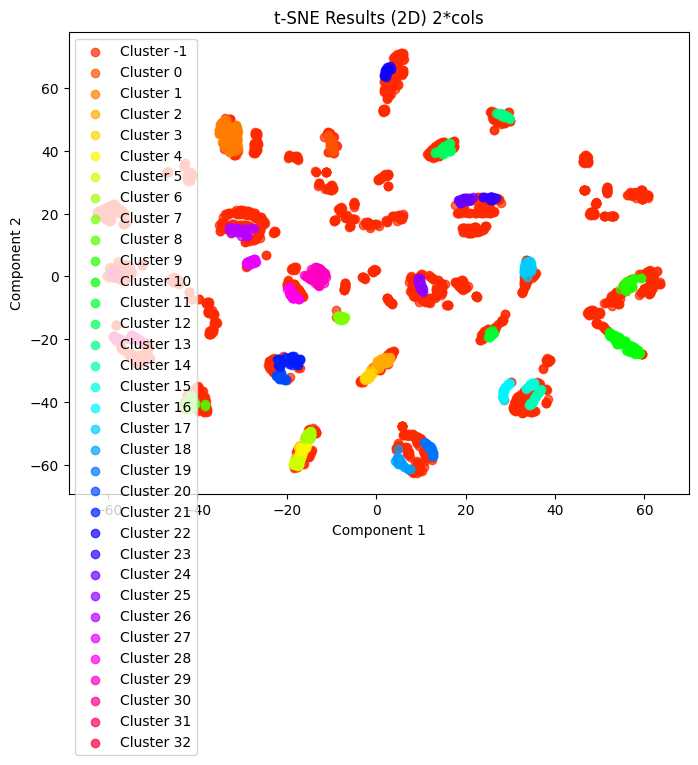

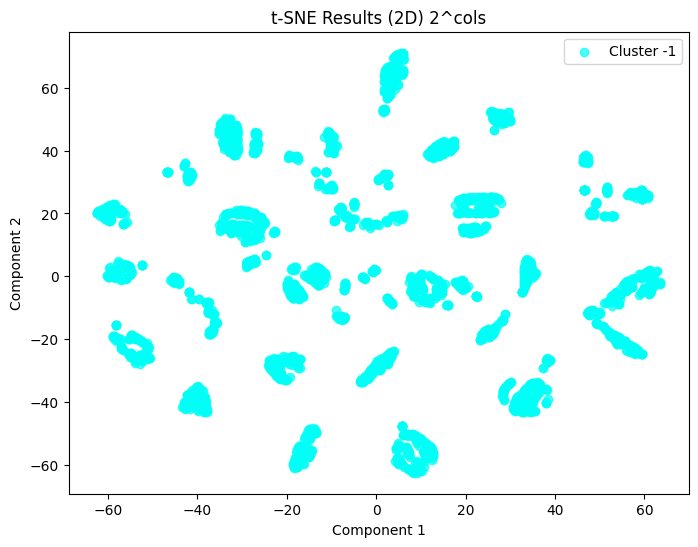

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


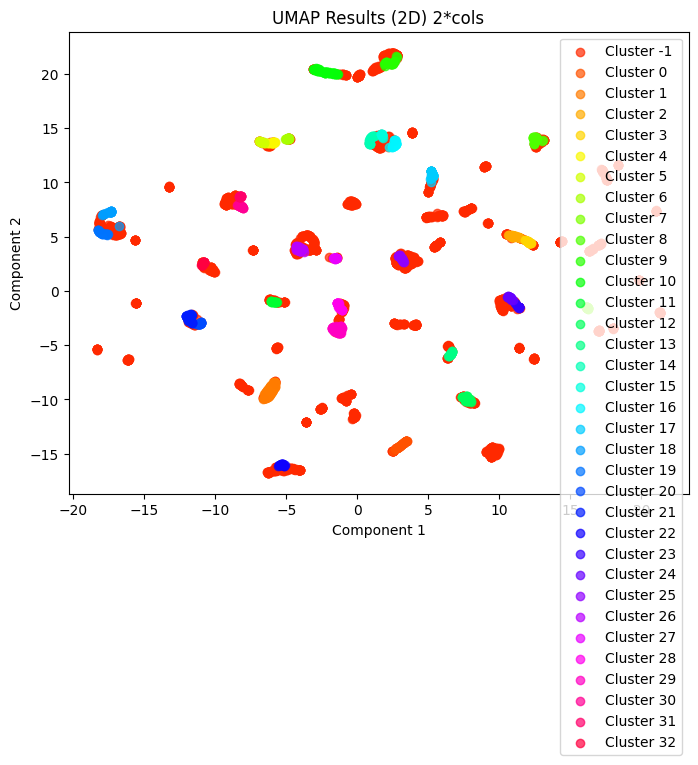

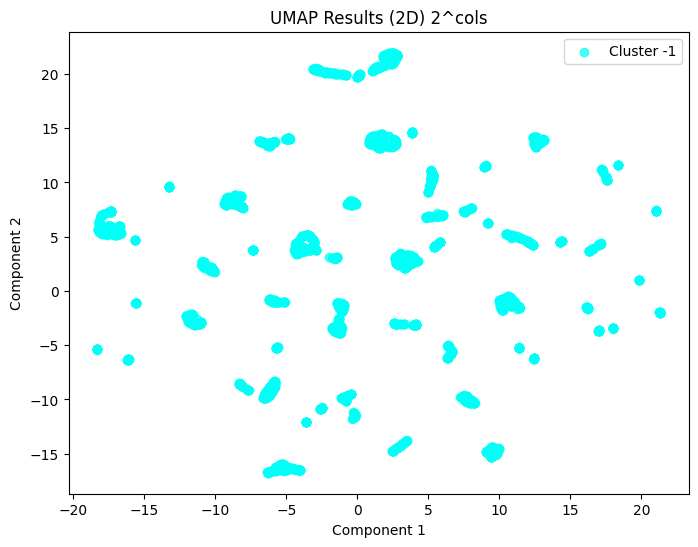

In [70]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels1)
clustering.similarity_matrix(real_stages_df, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)